In [2]:
%matplotlib inline

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import cm

import ipyparallel as ipp

from time import time
from datetime import datetime

import motif as mf

from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.decomposition import PCA
from sklearn.utils import shuffle
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate, RepeatedKFold

from scipy.stats import spearmanr
from scipy.stats import pearsonr

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [3]:
### set parameters for the motif analysis

PROTEIN_NAME='T7 primase'
PROT_CONC=5 # free protein concentration at binding reation; PBM typically 0.1 and RNACompete typically 0.002
BOTH_STRANDS=False # wheter both strands are present for binding; True if double-stranded DNA or RNA is used as probes

STAGES=mf.stage(protein=PROTEIN_NAME)

In [4]:
### read data

dfprobes_raw=pd.read_csv('./data/T7/chip_B_favor.csv', sep=';')
print('Columns of imported Data File: %s'%dfprobes_raw.columns)

Columns of imported Data File: Index(['0_nuc', '1_nuc', '2_nuc', '3_nuc', '4_nuc', '5_nuc', '6_nuc', '7_nuc',
       '8_nuc', '9_nuc', '10_nuc', '11_nuc', '12_nuc', '13_nuc', '14_nuc',
       '15_nuc', '16_nuc', '17_nuc', '18_nuc', '19_nuc', '20_nuc', '21_nuc',
       '22_nuc', '23_nuc', '24_nuc', '25_nuc', '26_nuc', '27_nuc', '28_nuc',
       '29_nuc', '30_nuc', '31_nuc', '32_nuc', '33_nuc', '34_nuc', '35_nuc',
       'prim_only_score', 'prim', 'poly', 'seq'],
      dtype='object')


I: DNA probes detected!


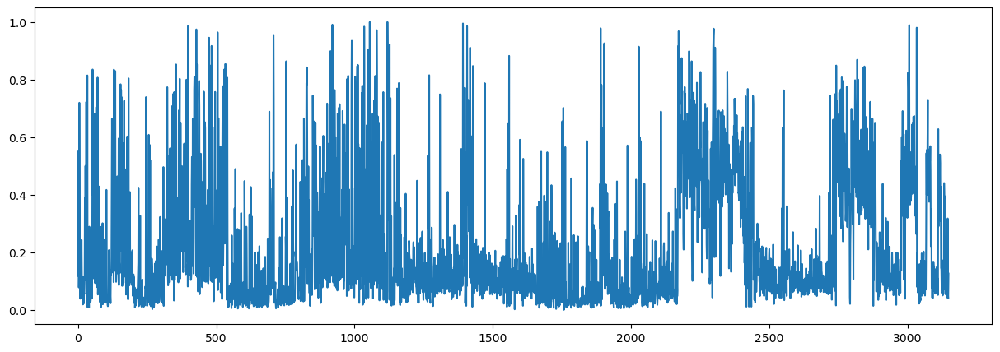

In [5]:
### select columns for probe sequence and signal

column_sequence='seq'
column_signal='prim_only_score'
#background_signal='mean_background_intensity'
background_signal=None                             #set to None if not needed

#basic preprocessing
dfprobes_raw[column_signal]=dfprobes_raw[column_signal].apply(lambda a: np.NaN if a==' ' else a)
dfprobes_raw[column_sequence]=dfprobes_raw[column_sequence].apply(lambda a: np.NaN if a=='nan' else a)
dfprobes_raw=dfprobes_raw.dropna()

#construct new dataframe with only necessary data
if type(background_signal)==type(None):
    dfprobes=pd.DataFrame({'seq':dfprobes_raw[column_sequence].astype(str),
                           'signal binding': dfprobes_raw[column_signal].astype(np.float32)}) #rebuild dataframe
else:
    dfprobes=pd.DataFrame({'seq':dfprobes_raw[column_sequence].astype(str),
                           'signal': dfprobes_raw[column_signal].astype(np.float32), 
                           'background':dfprobes_raw[background_signal].astype(np.float32)}) #rebuild dataframe
    dfprobes['signal binding']=dfprobes['signal']-dfprobes['background']
# display main properties of data set

dfprobes['signal binding']=dfprobes['signal binding']**2  # as raw data was squared

dfprobes['signal binding'].plot(figsize=(15,5))
dfprobes.describe()

### check type of nucleic acid

dfprobes['seq']=dfprobes['seq'].apply(lambda seq: seq.upper().replace(" ", ""))  #upper and remove blanks
dfprobes['RNA']=dfprobes['seq'].apply(lambda seq: all(char in 'ACGU' for char in seq))
dfprobes['DNA']=dfprobes['seq'].apply(lambda seq: all(char in 'ACGT' for char in seq))
non_RNA_counts=len(dfprobes[dfprobes['RNA']==False])
non_DNA_counts=len(dfprobes[dfprobes['DNA']==False])

if non_RNA_counts<non_DNA_counts:
    NUC_TYPE='RNA'; print('I: RNA probes detected!')
else: NUC_TYPE='DNA'; print('I: DNA probes detected!')
    
if NUC_TYPE=='RNA' and non_RNA_counts!=0:
    print('E: The probe sequences appear to be RNA, however there are some non-RNA nucleotides in the sequences.')
    print('E: Please check the following sequnces %s'%dfprobes[dfprobes['RNA']==False])

if NUC_TYPE=='DNA' and non_DNA_counts!=0:
    print('E: The probe sequences appear to be RNA, however there are some non-RNA nucleotides in the sequences.')
    print('E: Please check the following sequnces %s'%dfprobes[dfprobes['DNA']==False])

In [6]:
### option to add a constant sequence at the 3' end and 5' end
sequence_to_be_added_5='' 
sequence_to_be_added_3='GTCTTG'        # standard PBM arrays: CCTGTGTGAAATTGTTATCCGCTCT T7 array: GTCTTGA..
dfprobes['seq']=sequence_to_be_added_5.upper()+dfprobes['seq']+sequence_to_be_added_3.upper()
print(f"I: The nucleotide sequences {sequence_to_be_added_5.upper()} has been added to the 5' end all probe sequences.")
print(f"I: The nucleotide sequences {sequence_to_be_added_3.upper()} has been added to the 3' end all probe sequences.")

I: The nucleotide sequences  has been added to the 5' end all probe sequences.
I: The nucleotide sequences GTCTTG has been added to the 3' end all probe sequences.


I: Probe sequences have the uniform length of 42 nucleotides
I: Total datasets contains 3149 sequences.
I: Visualisation of the base composition per position
I: If positions are invariant they can be removed before sequence analysis.


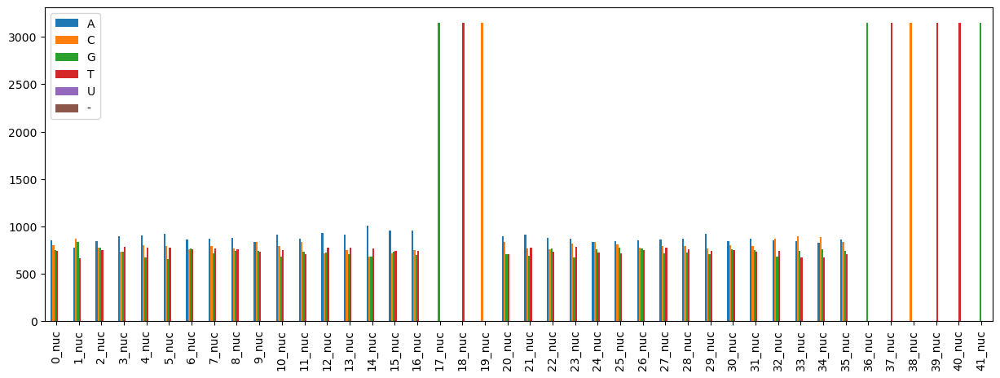

In [7]:
### egalize length
dfprobes['seq_length']=dfprobes['seq'].apply(len)    

if max(dfprobes['seq_length'])!=min(dfprobes['seq_length']):
    print('I: Probes length is not uniform, detected range: %i ..%i' %(min(dfprobes['seq_length']),max(dfprobes['seq_length'])))
    max_length=max(dfprobes['seq_length'])
    dfprobes['padded_sequence']=dfprobes['seq'].apply(lambda seq: seq+((max_length-len(seq))*'-'))
    print("I: Probe sequences have been padded at the 5' to the uniform length of %i nucleotides" %max_length)
else:
    print('I: Probe sequences have the uniform length of %i nucleotides' %(dfprobes['seq_length'].median()))
    dfprobes['padded_sequence']=dfprobes['seq']

print('I: Total datasets contains %i sequences.' % len(dfprobes))

# visualize composition of each position
df_nucleotides=mf.split_sequence_in_nucleotides(dfprobes['padded_sequence'])
dfcount=pd.DataFrame(index=['A', 'C', 'G', 'T', 'U', '-'])
for column in df_nucleotides:
    dfcount[column]=df_nucleotides[column].value_counts() 
dfcount=dfcount.fillna(0) #zeros for NaN
dfcount.transpose().plot(figsize=(15,5), kind='bar')
print('I: Visualisation of the base composition per position')
print('I: If positions are invariant they can be removed before sequence analysis.')

I: Visualisation of the base composition per position after slicing.


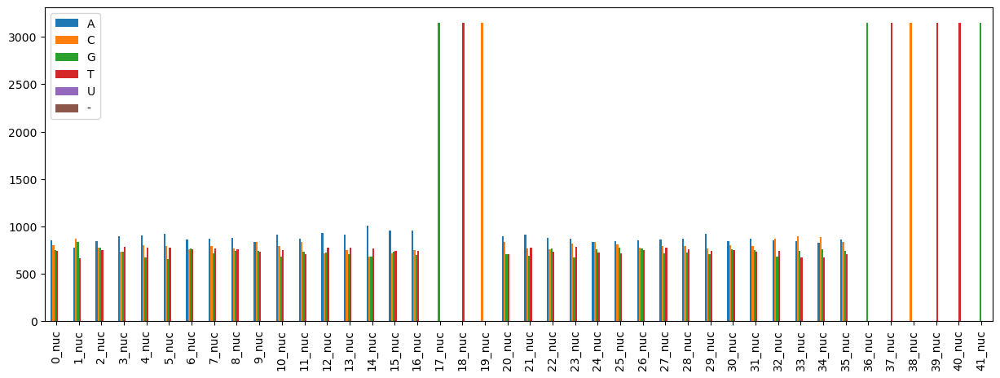

I: The whole dataset has been used to set the threshold for a positive probe.
T: The threshold is 0.663948
I: 196 probes of 3149 are above threshold.


In [8]:
# You may remove invariant continuos positions by adjusting the slicing. 
# It is recommended to leave a few invariant positions to allow for binding events
# between the variable and constant part of the probes.

dfprobes['padded_sequence']=dfprobes['padded_sequence'].apply(lambda s:s[:43]) ### <==== do the slicing here

# visualize composition of each position
print('I: Visualisation of the base composition per position after slicing.')
df_nucleotides=mf.split_sequence_in_nucleotides(dfprobes['padded_sequence'])
dfcount=pd.DataFrame(index=['A', 'C', 'G', 'T', 'U', '-'])
for column in df_nucleotides:
    dfcount[column]=df_nucleotides[column].value_counts() 
dfcount=dfcount.fillna(0) #zeros for NaN
dfcount.transpose().plot(figsize=(15,5), kind='bar')
plt.show()

### Preparation for later classification
mean=dfprobes['signal binding'].mean()
std=dfprobes['signal binding'].std()
THRESHOLD=mean+2*std   
dfprobes['positive probe']=dfprobes['signal binding'].apply(lambda s: True if s>THRESHOLD else False)

print('I: The whole dataset has been used to set the threshold for a positive probe.')
print('T: The threshold is %f' %THRESHOLD)
print(f"I: {len(dfprobes[dfprobes['positive probe']])} probes of {len(dfprobes)} are above threshold.")

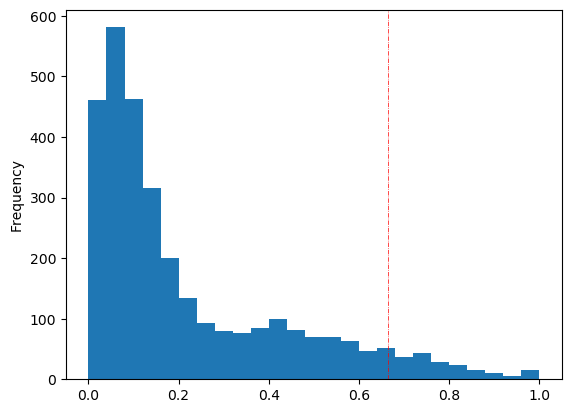

In [9]:
### Shuffle and prepare dataset for training and testing

# shuffle 
dfprobes = shuffle(dfprobes)

# display histogramms of dataset
dfprobes['signal binding'].plot(kind='hist', bins=25).axvline(x=THRESHOLD, color='r', linestyle='-.', lw=0.5, label='threshold classification')

# complete data
X=mf.hotencode_sequence(dfprobes['padded_sequence'], nuc_type=NUC_TYPE)
y=np.array(dfprobes['signal binding'])

Fitting 50 folds for each of 6 candidates, totalling 300 fits
I: GridSearchCV took 14.19 hours for 6 candidate parameter settings.
I: number of samples: 3149
I: Plot of r vs motif length


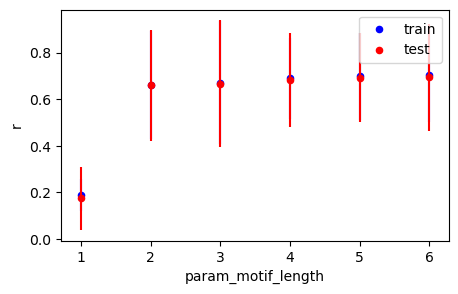

,param_motif_length,r(test),r(train)
0,1,0.173419,0.187203
1,2,0.658905,0.660726
2,3,0.666561,0.670032
3,4,0.682361,0.689046
4,5,0.691722,0.697365
5,6,0.694235,0.701794


In [10]:
#### Perfrom GridCV Search for exploration of the motif length and other model parameters 
# primary goal: identify the minimum motif length which gives a good r-value
# optional: allow also for global optimization to verify whether the local optimization is good enough
# optional: vary G0 to find a good regression model
# optional: fitG0=True. This option adjust G0, so that maximal binding is around 1 (prevents saturation of probes by multiple binding events)


model_grid=mf.findmotif(protein_conc=PROT_CONC, both_strands=BOTH_STRANDS, fit_G0=True)

# prepare grid search over parameters
param_grid = {"motif_length": [1,2,3,4,5,6]}     # choose sensible range for length of motif and other parameters

# run grid search
grid_search = GridSearchCV(model_grid, param_grid=param_grid, verbose=2, 
                           cv=RepeatedKFold(n_splits=5, n_repeats=10),
                           n_jobs=-1,
                           return_train_score=True)

start = time()
grid_search.fit(X, y)
df_grid=pd.DataFrame(grid_search.cv_results_)

print("I: GridSearchCV took %.2f hours for %d candidate parameter settings."
    % ((time() - start)/3600, len(grid_search.cv_results_["params"])))
print('I: number of samples: %i' %len(X))

df_grid=pd.DataFrame(grid_search.cv_results_)

print('I: Plot of r vs motif length')
df_grid['r(train)']=df_grid['mean_train_score'].apply(np.sqrt)
df_grid['r(test)']=df_grid['mean_test_score'].apply(np.sqrt)
df_grid['std(train)']=df_grid['std_train_score'].apply(np.sqrt)
df_grid['std(test)']=df_grid['std_test_score'].apply(np.sqrt)


fig, ax=plt.subplots()
df_grid.plot(ax=ax,kind='scatter', x='param_motif_length', y='r(train)', yerr='std(train)', figsize=(5,3), c='blue').set_xticks(param_grid["motif_length"])
df_grid.plot(ax=ax,kind='scatter', x='param_motif_length', y='r(test)', yerr='std(test)', c='red')
ax.set_ylabel('r')
ax.legend(['train', 'test'])
plt.show()
df_grid[['param_motif_length','r(test)', 'r(train)']]

  0%|          | 0/16 [00:00<?, ?engine/s]

single_job:   0%|          | 0/200 [00:00<?, ?tasks/s]

I: Optimization took 10.22 hours.
I: Results of the repeated motif finding, sorted according to the regression coefficient


,model,r,G0,max binding,min binding,ratio,energies,information,logo
184,suppressed,0.709102,-8369.682846,0.961111,3.057673e-01,3.143276e+00,"-6305,..",2.372494,
60,suppressed,0.709079,-6483.433347,0.969193,3.052673e-01,3.174901e+00,"-6098,..",2.434594,
68,suppressed,0.708971,-9111.459686,0.970340,3.117814e-01,3.112246e+00,"-5960,..",2.360772,
63,suppressed,0.708837,-8917.596818,0.968301,3.115061e-01,3.108449e+00,"-4911,..",2.374628,
144,suppressed,0.708727,-9858.288782,0.975751,3.108550e-01,3.138928e+00,"-6247,..",2.281839,
114,suppressed,0.708587,-10537.550819,0.977608,3.110741e-01,3.142686e+00,"-5771,..",2.270755,
108,suppressed,0.708546,-11716.668946,0.982724,3.243494e-01,3.029831e+00,"-5044,..",2.231729,
107,suppressed,0.708505,-10799.940918,0.983687,3.207868e-01,3.066482e+00,"-4894,..",2.240343,
98,suppressed,0.708344,-9607.492522,0.961975,3.210375e-01,2.996457e+00,"-6141,..",2.295675,
43,suppressed,0.708297,-12027.574721,0.980347,3.232646e-01,3.032646e+00,"-4163,..",2.262535,

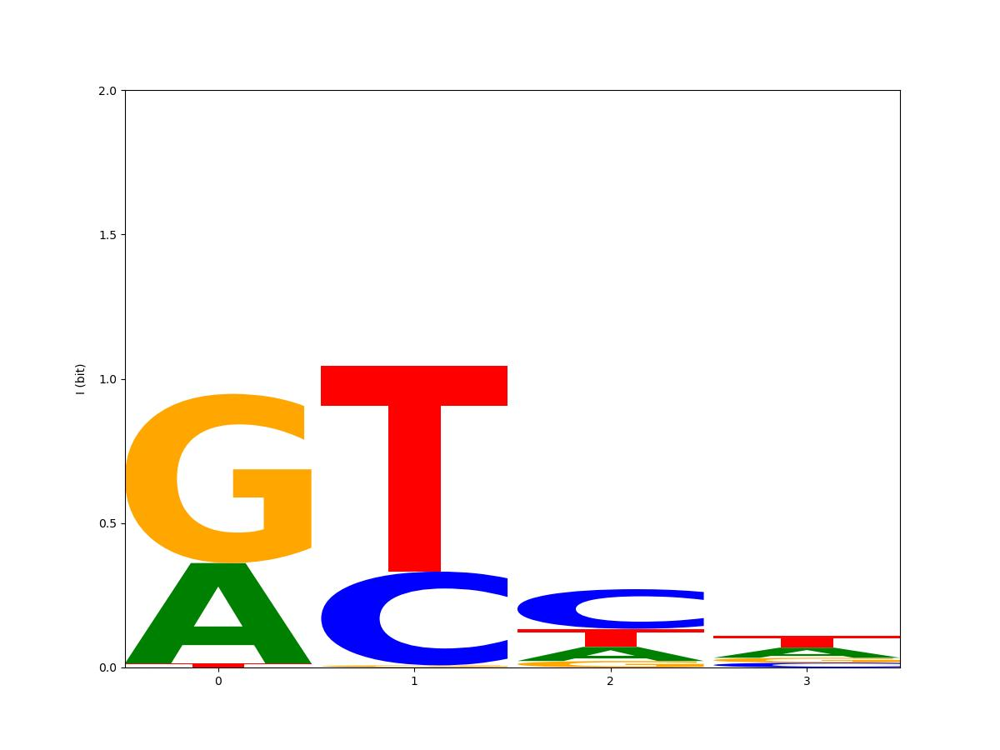
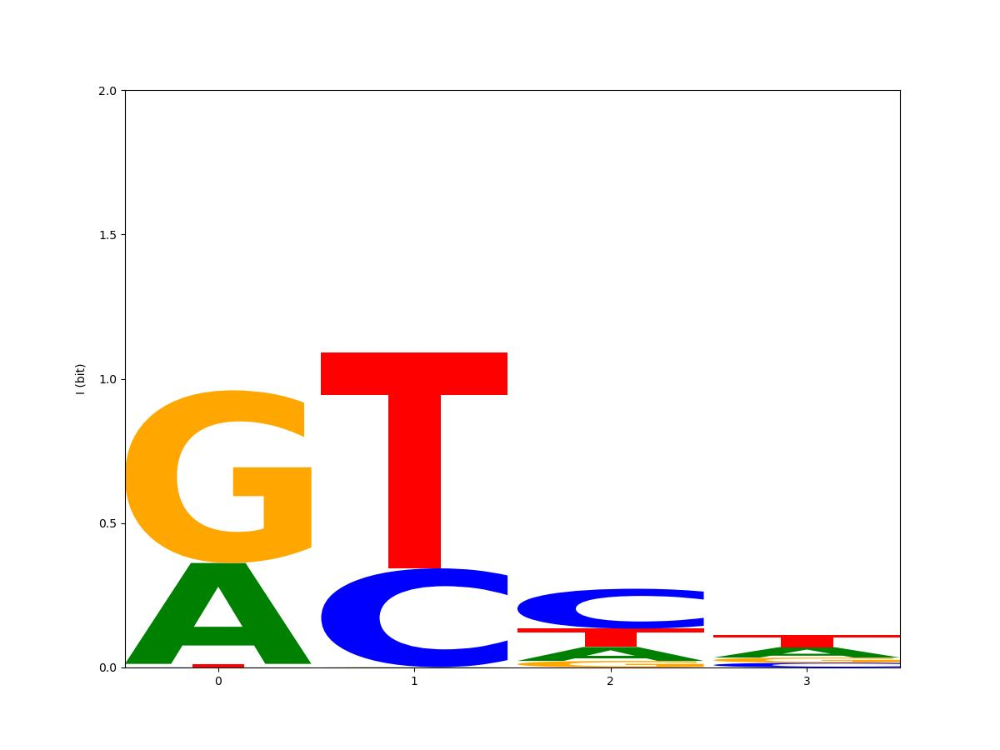
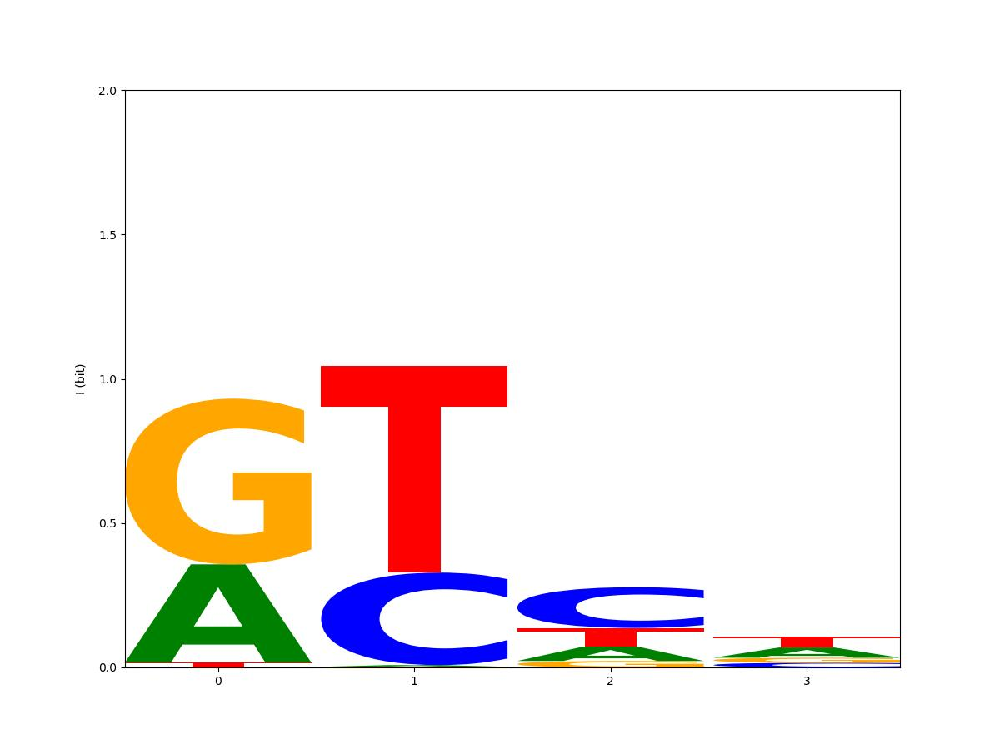
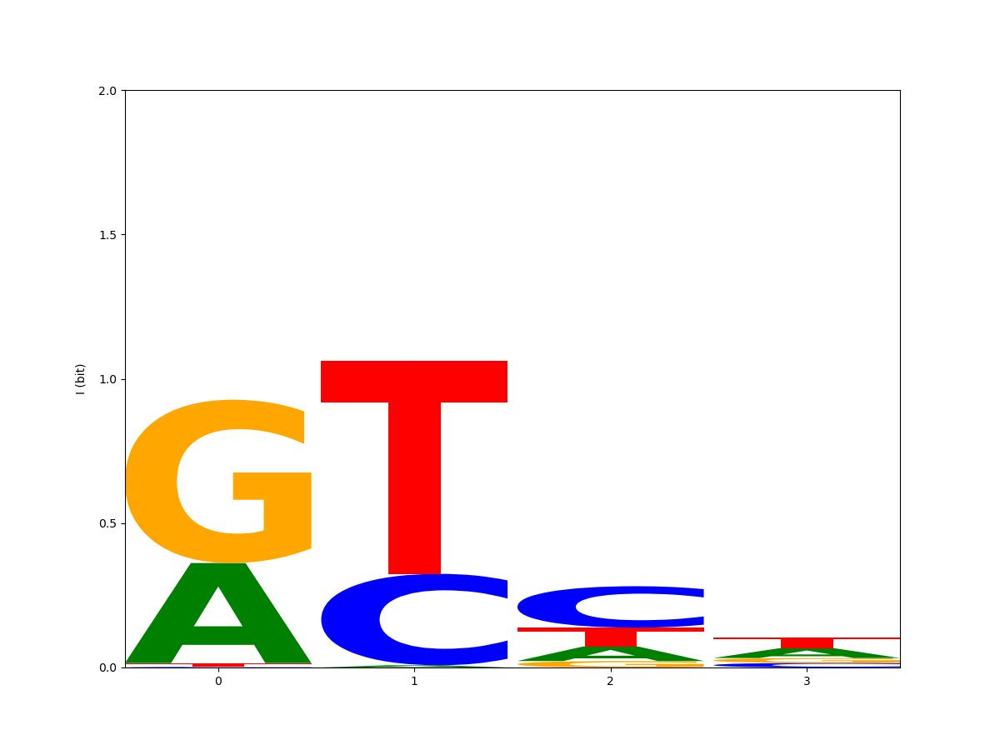
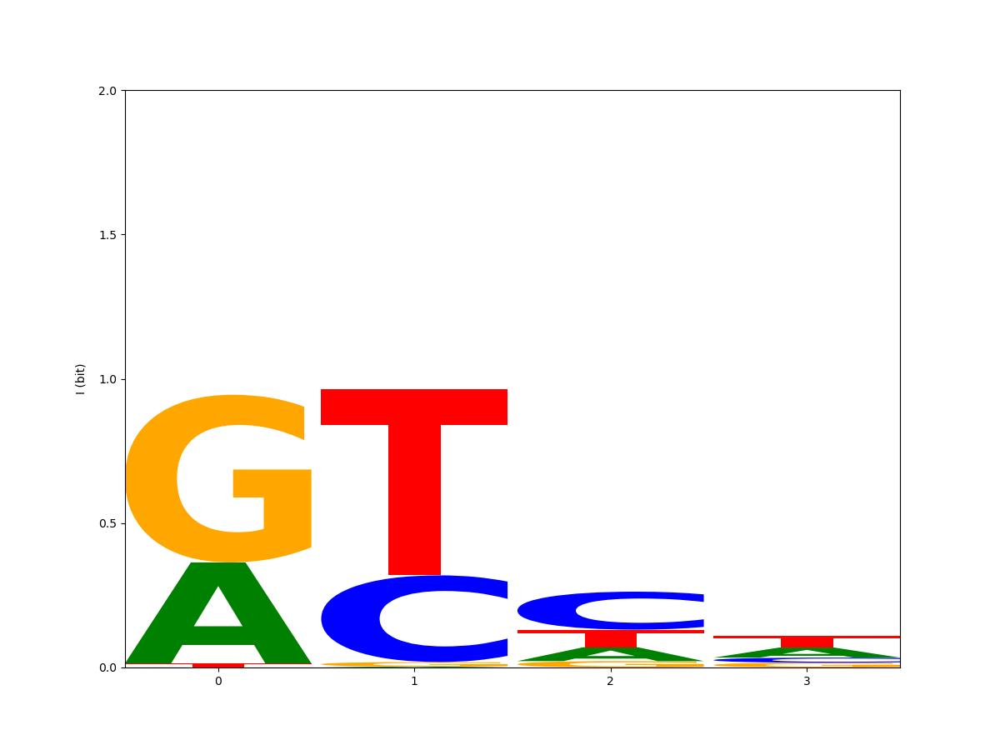
...
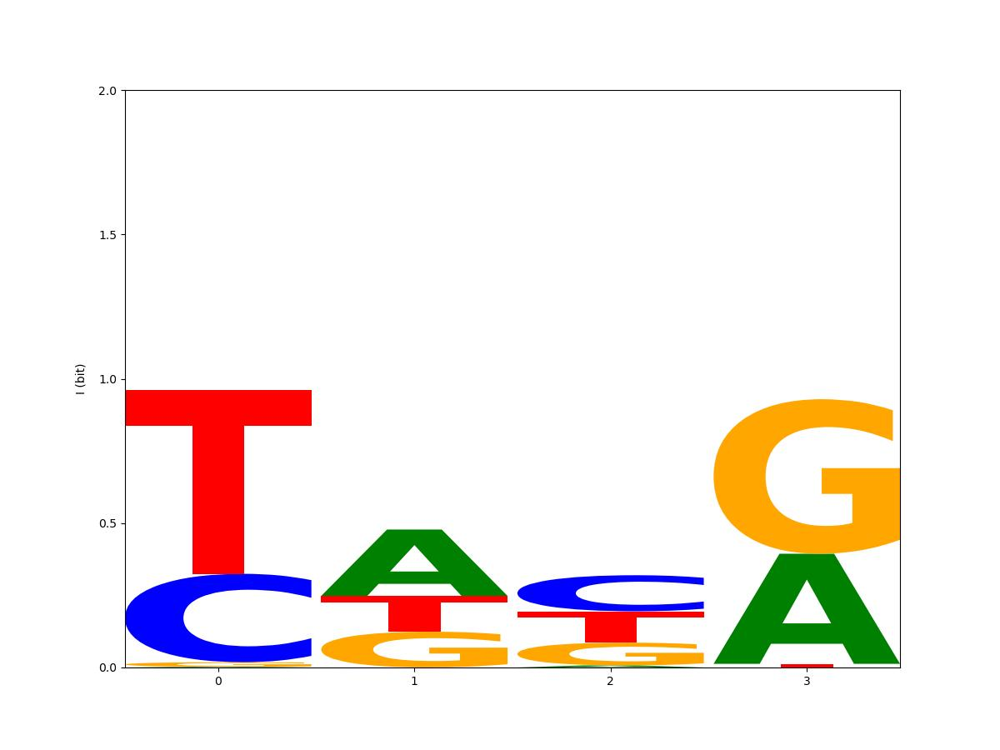
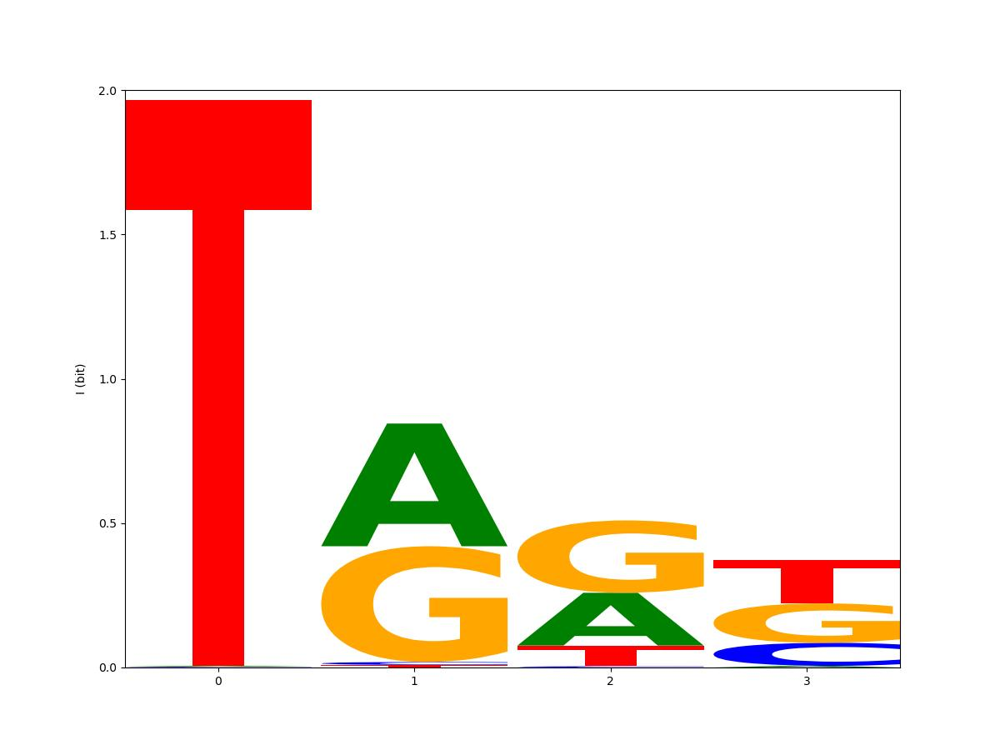
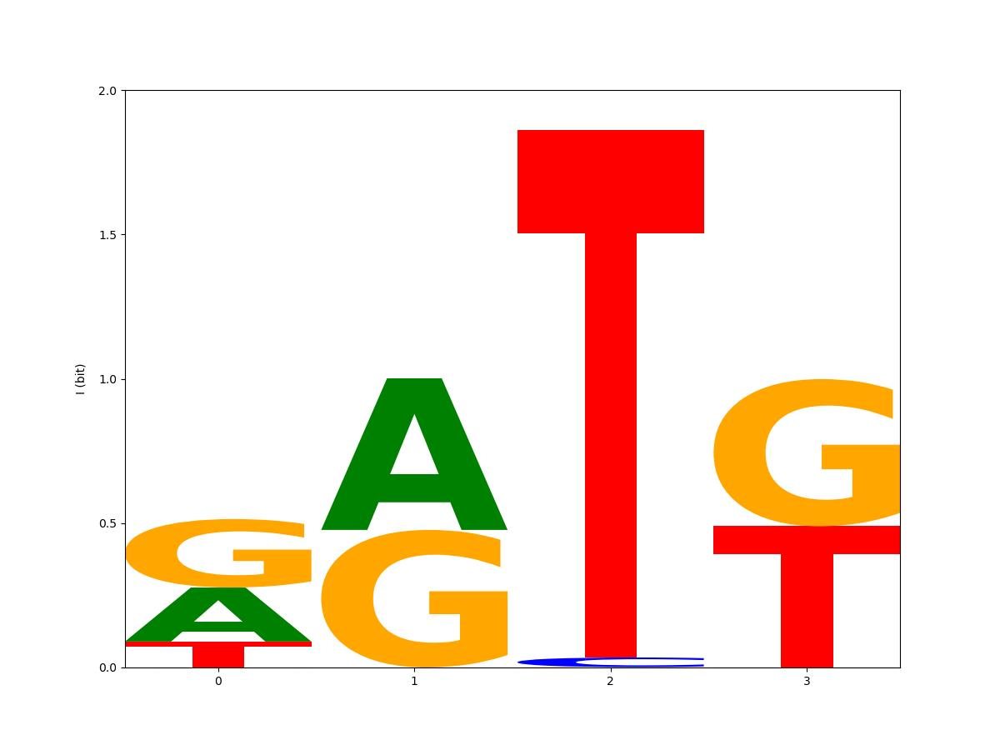
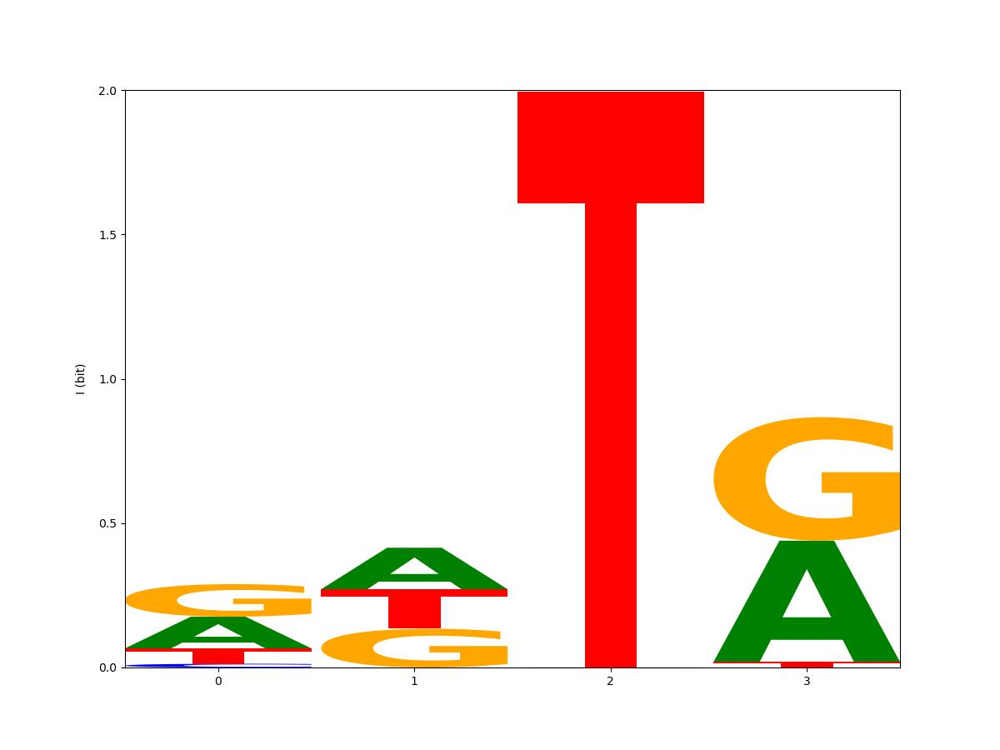
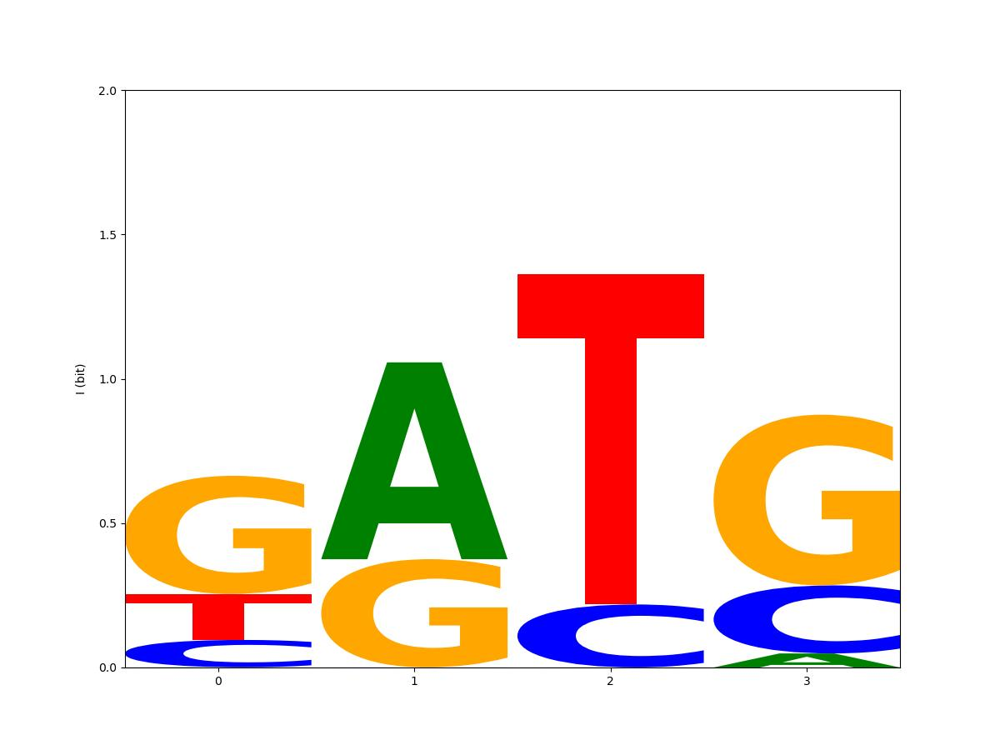

In [11]:
### run a number of identical optimizations with motif length found during grid search
### goal: find best motif through repetition, judge stabiltiy of optimization

CORE_MOTIF_LENGTH=4  # adjust core motif length if needed, motif length can be changed later

# prepare for ipyparallel
number_of_optimizations = 200
model_list = [mf.findmotif(motif_length=CORE_MOTIF_LENGTH, protein_conc=PROT_CONC, both_strands=BOTH_STRANDS, fit_G0=True)] * number_of_optimizations
X_list = [X] * number_of_optimizations
y_list = [y] * number_of_optimizations


def single_job(model, X, y):
    model.fit(X, y)
    return {'model':model}

# run the optimizations on ipp.cluster
start = time()
with ipp.Cluster(log_level=40) as rc:
    rc[:].use_pickle()
    view = rc.load_balanced_view()
    asyncresult = view.map_async(single_job, model_list, X_list, y_list)
    asyncresult.wait_interactive()
    result = asyncresult.get()
print("I: Optimization took %.2f hours." % ((time() - start) / 3600))


  
# assemble results and analyze
df_repetitions=pd.DataFrame(result)
df_repetitions['r']=df_repetitions['model'].apply(lambda e: mf.linregress(e.predict(X),y).rvalue)
df_repetitions['G0']=df_repetitions['model'].apply(lambda e: e.finalG0_)
df_repetitions['max binding']=df_repetitions['model'].apply(lambda e: e.max_binding_fit)
df_repetitions['min binding']=df_repetitions['model'].apply(lambda e: e.min_binding_fit)
df_repetitions['ratio'] = df_repetitions['model'].apply(lambda e: e.ratio)
df_repetitions['energies']=df_repetitions['model'].apply(lambda e: e.energies_)
df_repetitions['information']=df_repetitions['model'].apply(lambda e: mf.energies2information(e.energies_))


# display results of the ensemble of optimizations
print('I: Results of the repeated motif finding, sorted according to the regression coefficient')
df_repetitions.sort_values('r', ascending=False, inplace=True)
mf.display_df(df_repetitions, nuc_type=NUC_TYPE)

In [12]:
df_repetitions=df_repetitions[:-int(len(df_repetitions)/20)] #delete 5% worst

I: Histogram of the regression coefficients r obtained by repeated optimizaion with the subset.


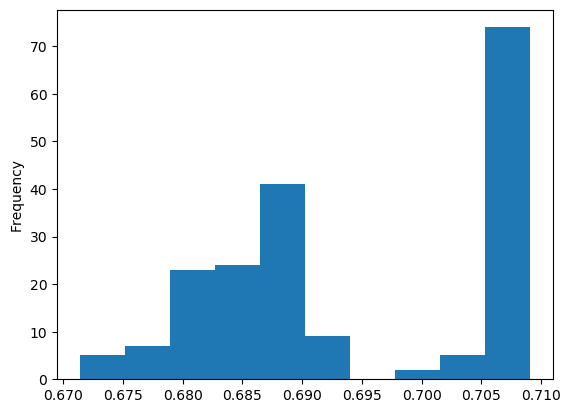

I: 2-dimensional PCA explained 80 % of variance.
I: Visualization of the PCA with the regression quality by color.


/home/GLipps/.local/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute `n_features_` was deprecated in version 1.2 and will be removed in 1.4. Use `n_features_in_` instead.
  warnings.warn(msg, category=FutureWarning)


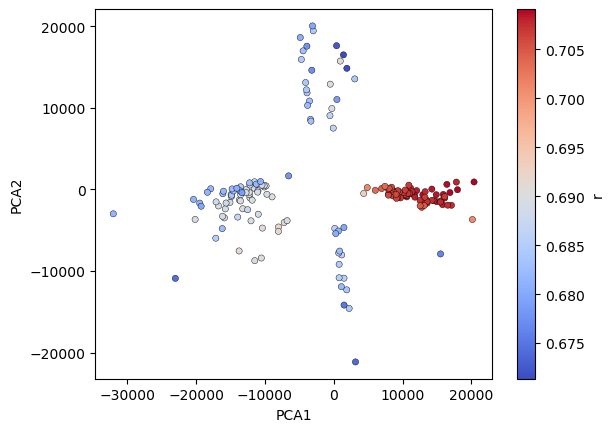

In [13]:
### compare energy matrices of ensemble using PCA
print('I: Histogram of the regression coefficients r obtained by repeated optimizaion with the subset.')
df_repetitions['r'].plot(kind='hist')
plt.show()

pca = PCA(n_components=2)
pca_2c=pca.fit_transform(df_repetitions['energies'].tolist())    
df_repetitions[['PCA1', 'PCA2']]=pca_2c
print('I: 2-dimensional PCA explained %i %% of variance.' %(sum(pca.explained_variance_ratio_)*100))
if sum(pca.explained_variance_ratio_)<0.5:
      print('W: 2-dimensional PCA explained only %i %% of variance' %(sum(pca.explained_variance_ratio_)*100))

print('I: Visualization of the PCA with the regression quality by color.')        
df_repetitions.plot(x='PCA1', y='PCA2', kind='scatter', c='r',cmap=cm.coolwarm, edgecolors='black', linewidths=0.3)


,model,r,G0,max binding,min binding,ratio,energies,information,logo,PCA1,PCA2
184,suppressed,0.709102,-8369.682846,0.961111,0.305767,3.143276,"-6305,..",2.372494,,17988.736468,-39.460457
60,suppressed,0.709079,-6483.433347,0.969193,0.305267,3.174901,"-6098,..",2.434594,,20391.888512,913.429057
68,suppressed,0.708971,-9111.459686,0.970340,0.311781,3.112246,"-5960,..",2.360772,,16887.932155,-386.841108
63,suppressed,0.708837,-8917.596818,0.968301,0.311506,3.108449,"-4911,..",2.374628,,16443.067048,616.642582
144,suppressed,0.708727,-9858.288782,0.975751,0.310855,3.138928,"-6247,..",2.281839,,15918.681832,-617.144040
114,suppressed,0.708587,-10537.550819,0.977608,0.311074,3.142686,"-5771,..",2.270755,,14895.509678,-651.561250
108,suppressed,0.708546,-11716.668946,0.982724,0.324349,3.029831,"-5044,..",2.231729,,12947.405513,-655.573760
107,suppressed,0.708505,-10799.940918,0.983687,0.320787,3.066482,"-4894,..",2.240343,,14256.905212,40.058050
98,suppressed,0.708344,-9607.492522,0.961975,0.321038,2.996457,"-6141,..",2.295675,,16120.051120,-1053.813118
43,suppressed,0.708297,-12027.574721,0.980347,0.323265,3.032646,"-4163,..",2.262535,,12051.655413,-149.126292

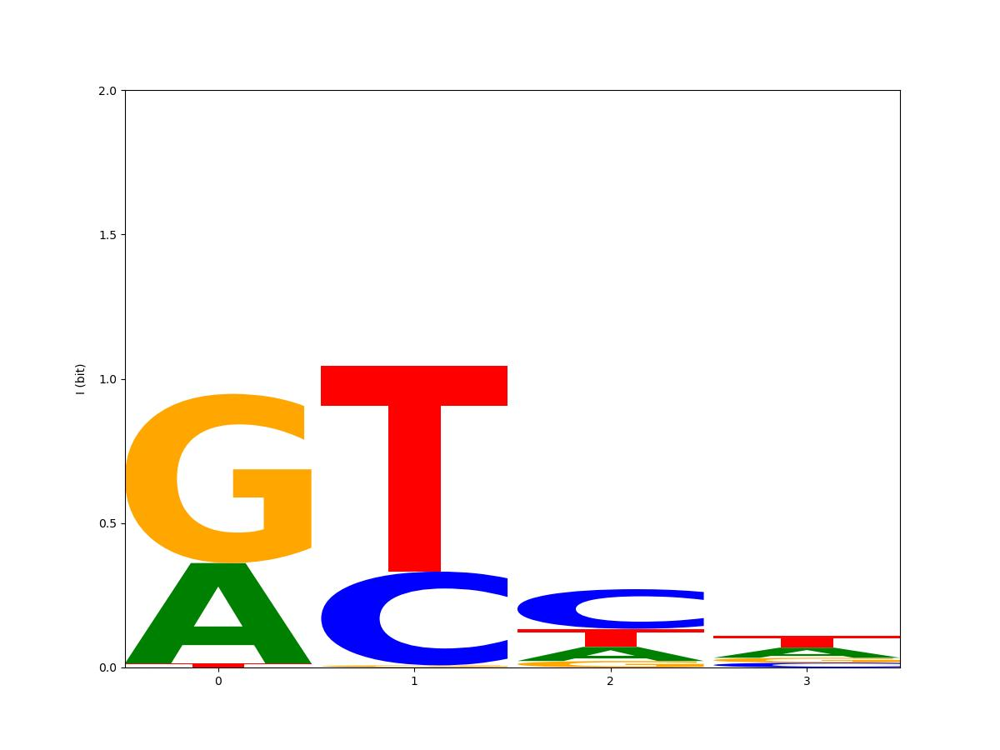
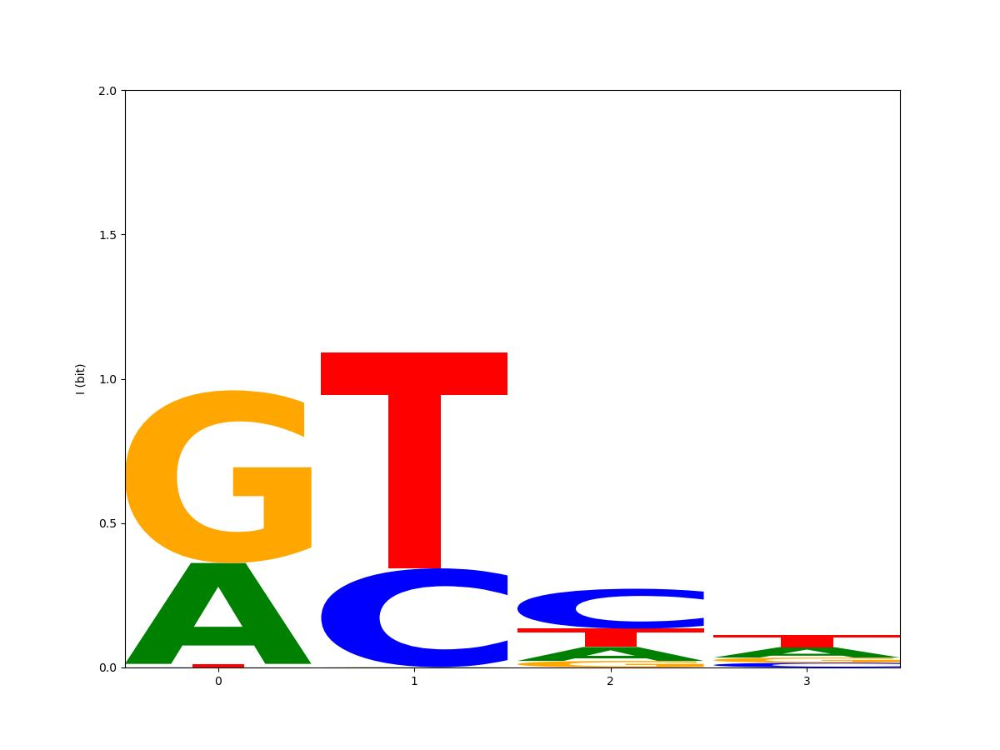
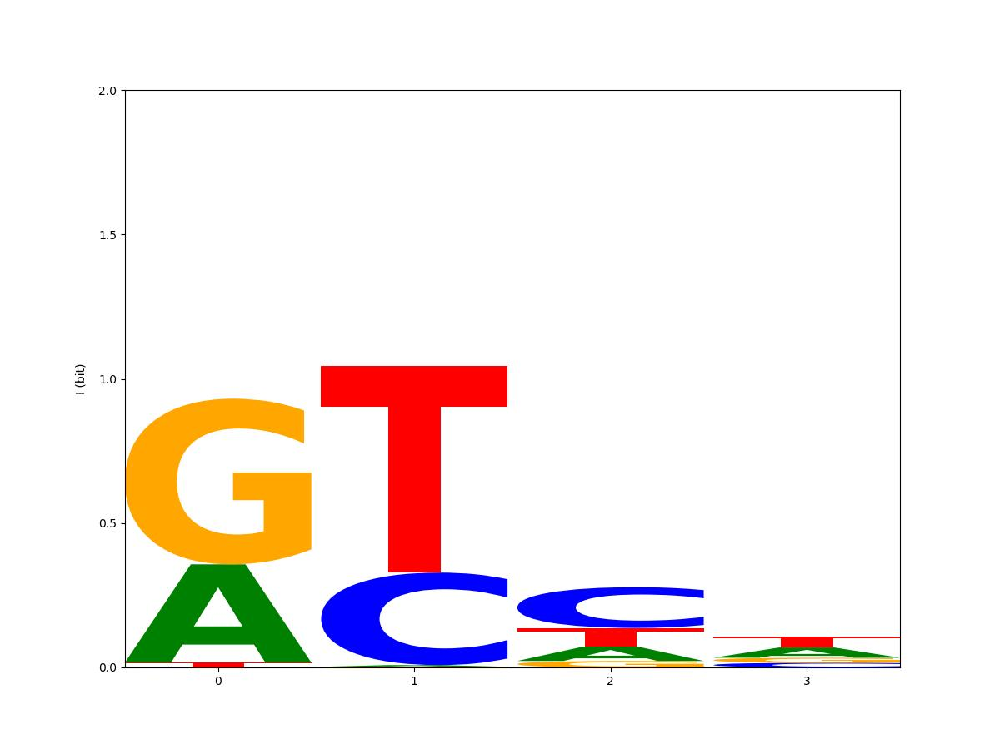
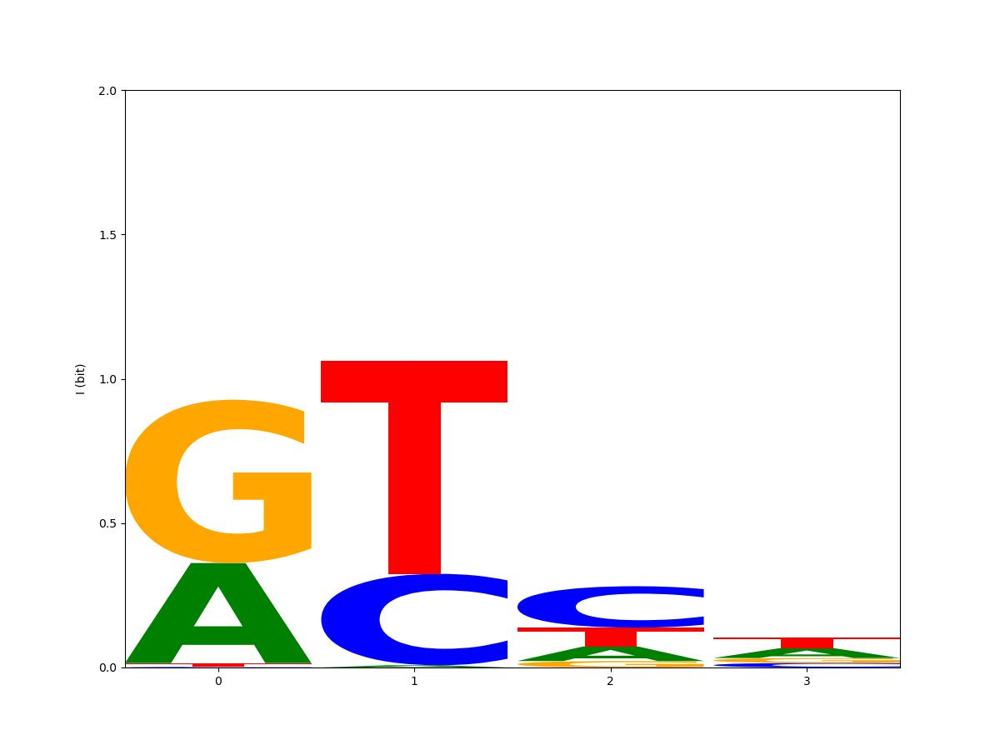
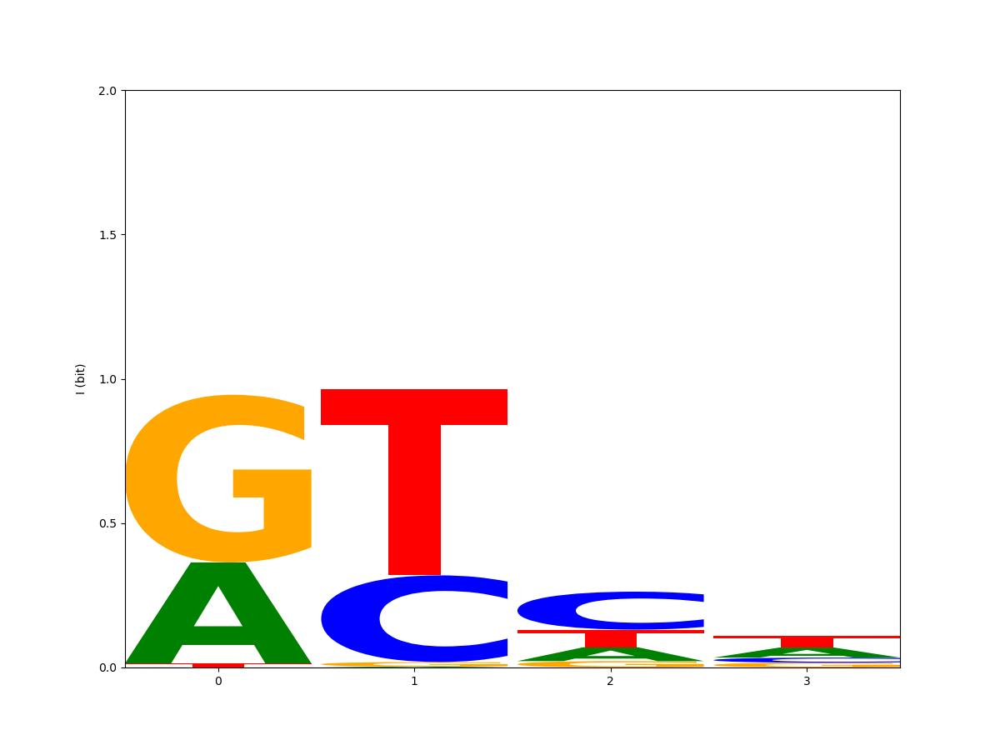
...
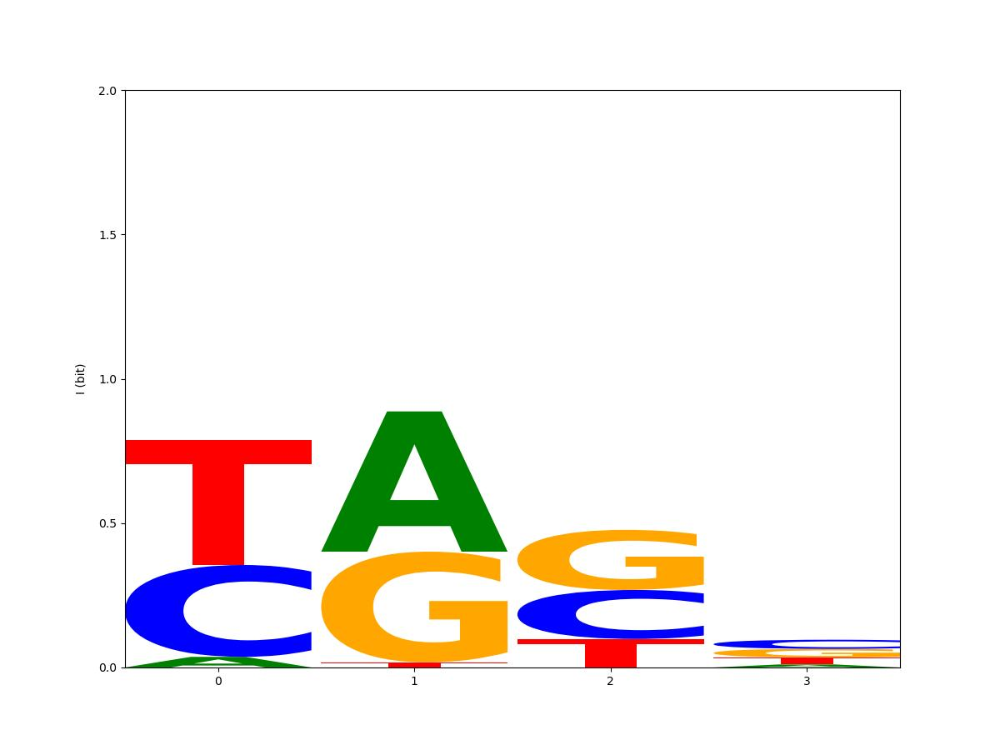
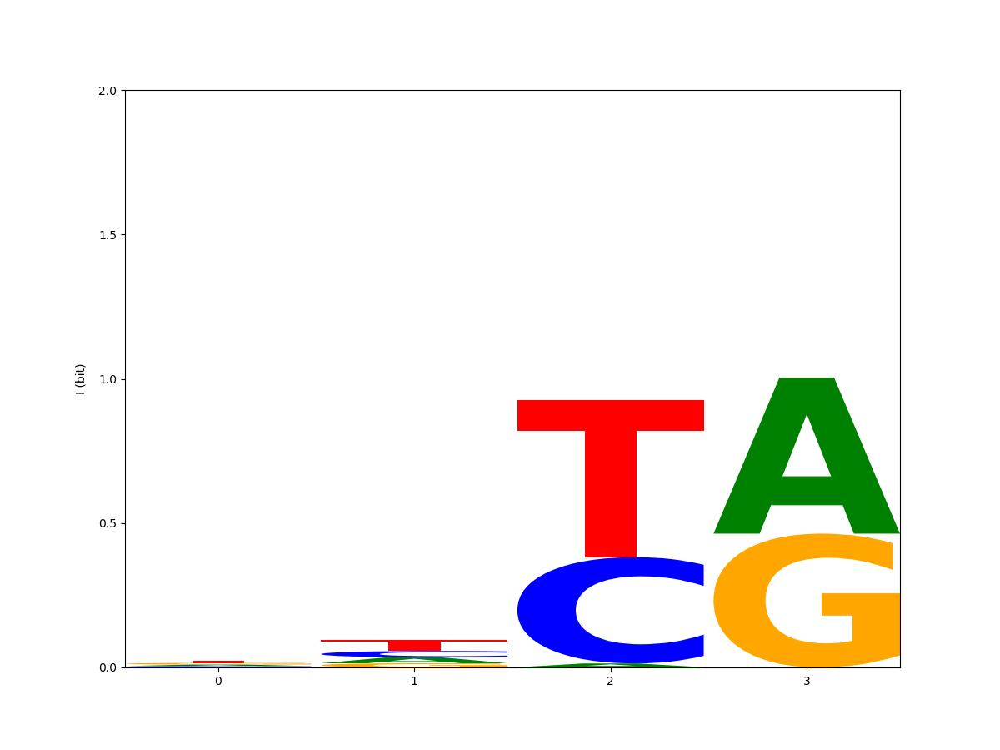
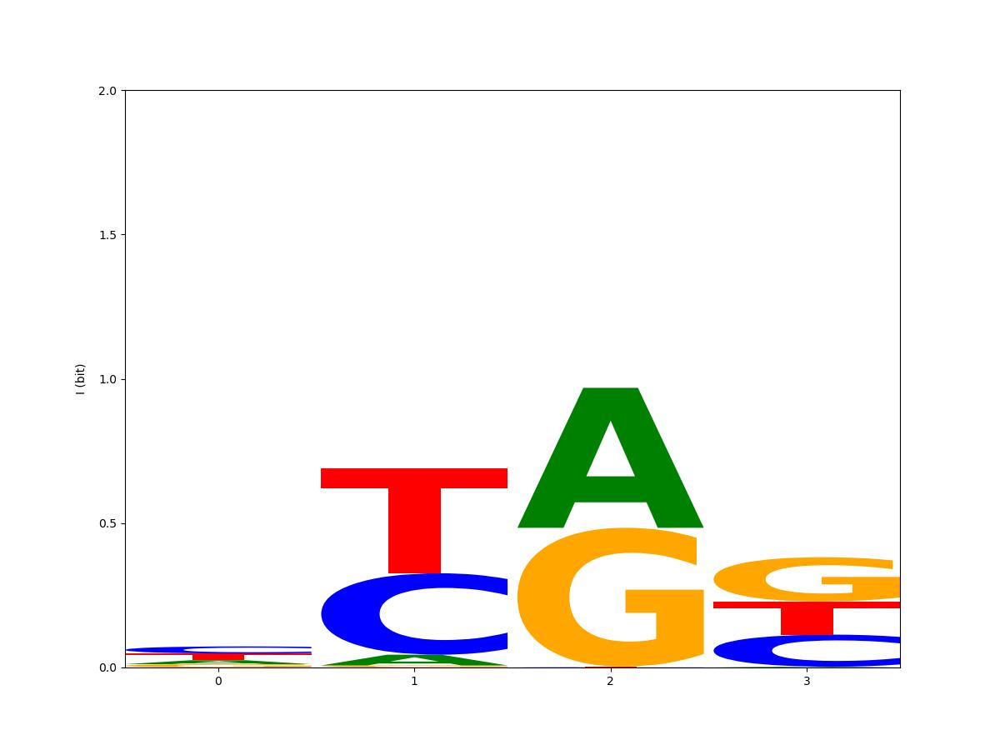
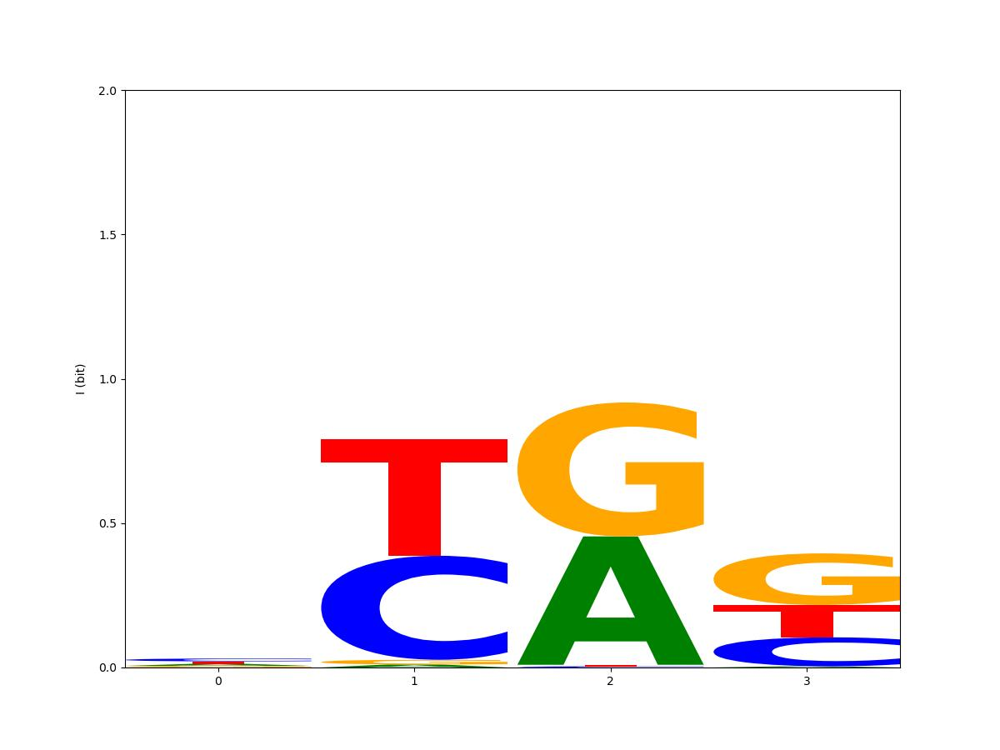
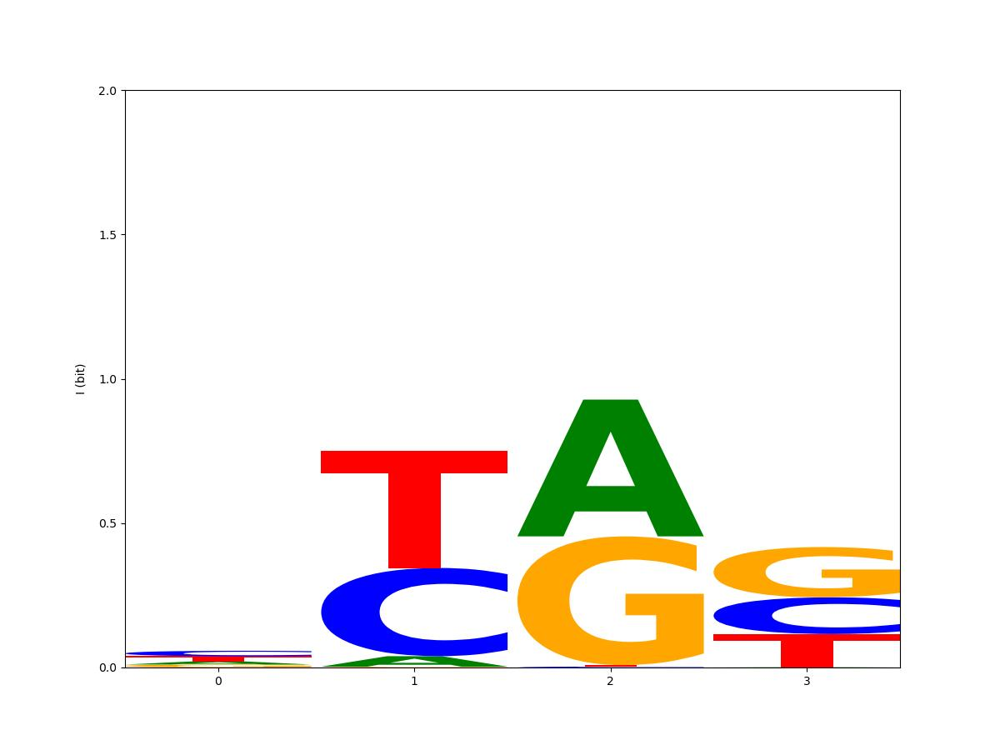

In [14]:
mf.display_df(df_repetitions, nuc_type=NUC_TYPE)

I: Best motif according to r from the repeated optimizations.
I: PCA components: 17988, -39
I: energy matrix and logos:



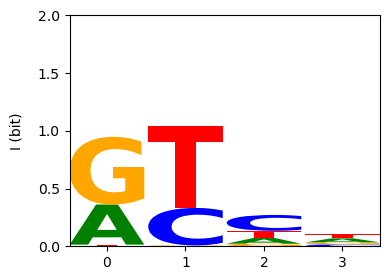

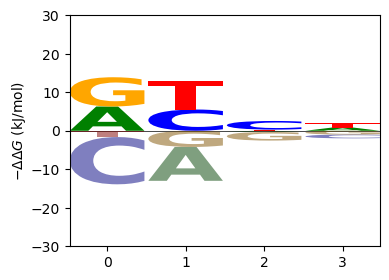


       A      C     G     T
0 -6305  12275 -7599  1630
1  8790  -5524  4206 -7472
2   317  -2245  2231  -303
3  -829    993   978 -1143

I: summed absolute energies of each position:
0    27811
1    25994
2     5097
3     3945
dtype: int64

I: averaged summed energy over all positions: 15712
I: Mean and Standard Deviation for the Free Energy G to all subsequences of all probes: -8569 +/- 9131
I: Plot of the Occupancy of a subsite as the function of the Free Energy G 
   overlaid with the distribution of the Free Energy of all subsites.
I: There shall be only a small overlap of both curves. i.e. only the most negative Free Energies
    lead to a measurable occupancy.


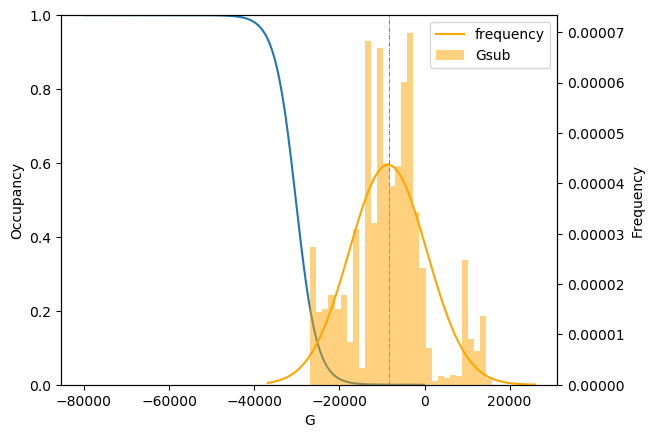

I: Calculated occupancy over all subsite of a single probe:
   binding:  0.30577 .. 0.96111 (ratio: 3.1)
I: number of probes: 3149
I: Pearson Correlation  r: 0.7091
I: mean absolute error: 0.1027


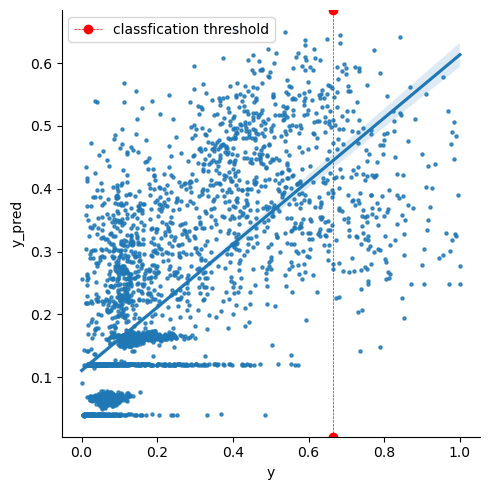

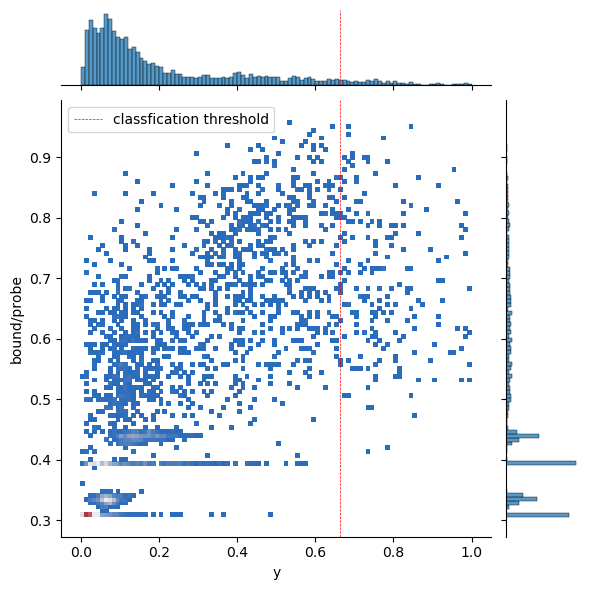

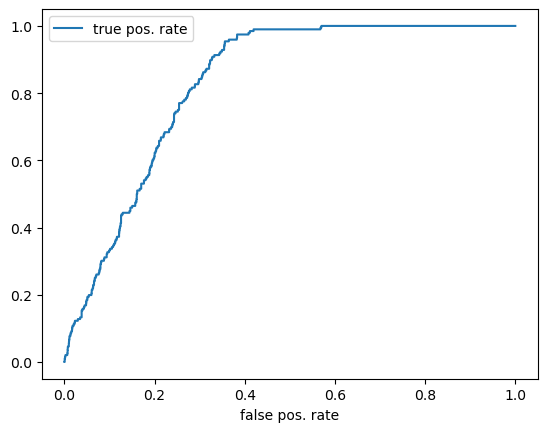

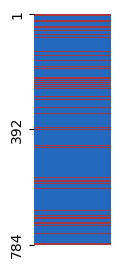

I: Classification performance AUROC: 0.8296


,stage,protein,# probes,motif length,r,AUROC,G0,G0 fitted,ratio,max binding,min binding,energies,model,logo
0,best repetition,T7 primase,3149,4,0.709102,0.829612,-8369.682846,True,3.143276,0.961111,0.305767,"-6305,..",suppressed,

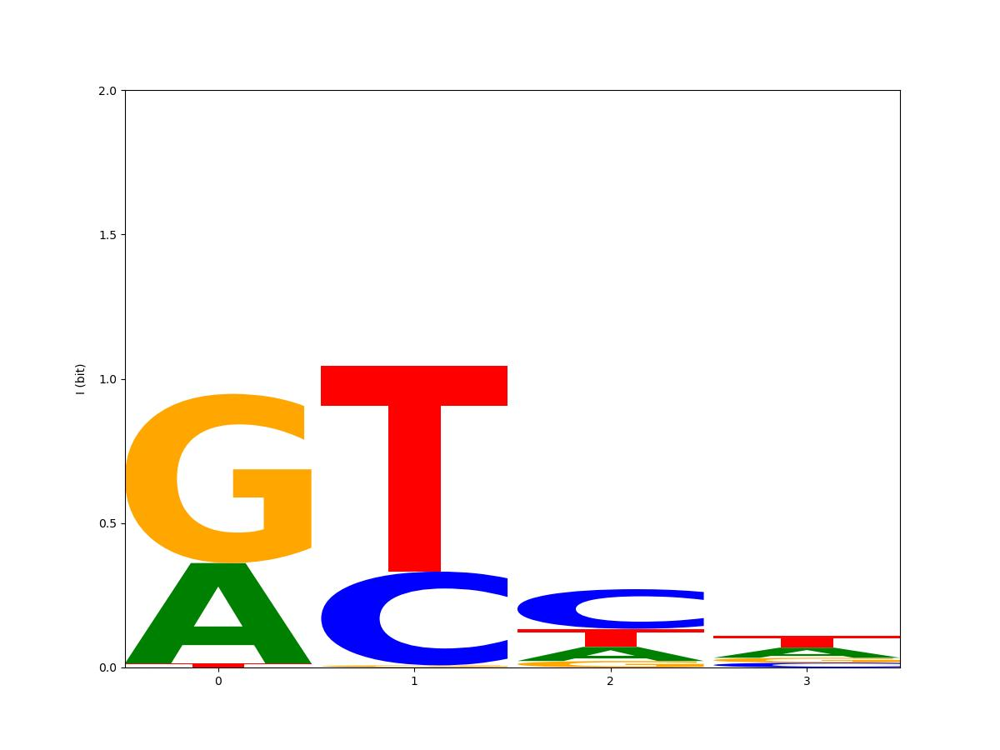

In [15]:
# visualisation of the motif with the highest r
print('I: Best motif according to r from the repeated optimizations.')
print('I: PCA components: %i, %i' %(df_repetitions.iloc[0]['PCA1'], df_repetitions.iloc[0]['PCA2']))
model_best_repetition=df_repetitions.iloc[0]['model']
model_best_repetition.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE) 
# store results and display stages
STAGES.append('best repetition', model_best_repetition)
mf.display_df(STAGES.df, nuc_type=NUC_TYPE)

Optimization terminated successfully.
         Current function value: 0.098388
         Iterations: 8
         Function evaluations: 1634
I: energy matrix and logos:



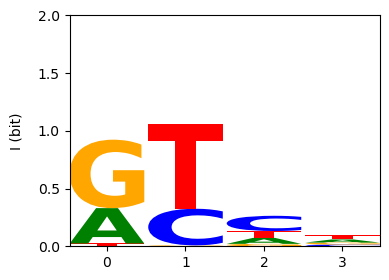

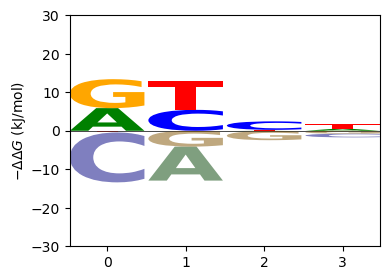


       A      C     G     T
0 -5884  12970 -7518   431
1  8824  -5437  4115 -7502
2   105  -2208  2341  -238
3  -482    976   745 -1238

I: summed absolute energies of each position:
0    26804
1    25880
2     4894
3     3442
dtype: int64

I: averaged summed energy over all positions: 15255
I: Mean and Standard Deviation for the Free Energy G to all subsequences of all probes: -8575 +/- 9400
I: Plot of the Occupancy of a subsite as the function of the Free Energy G 
   overlaid with the distribution of the Free Energy of all subsites.
I: There shall be only a small overlap of both curves. i.e. only the most negative Free Energies
    lead to a measurable occupancy.


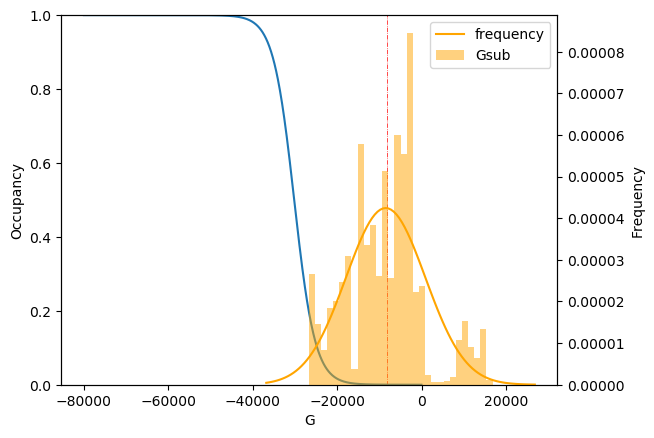

I: Calculated occupancy over all subsite of a single probe:
   binding:  0.31222 .. 0.95738 (ratio: 3.1)
I: number of probes: 3149
I: Pearson Correlation  r: 0.6958
I: mean absolute error: 0.0984


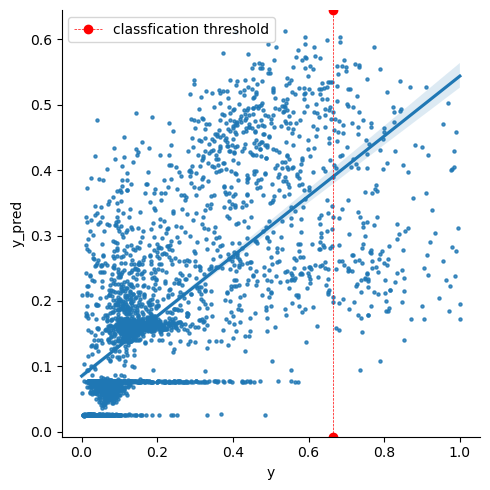

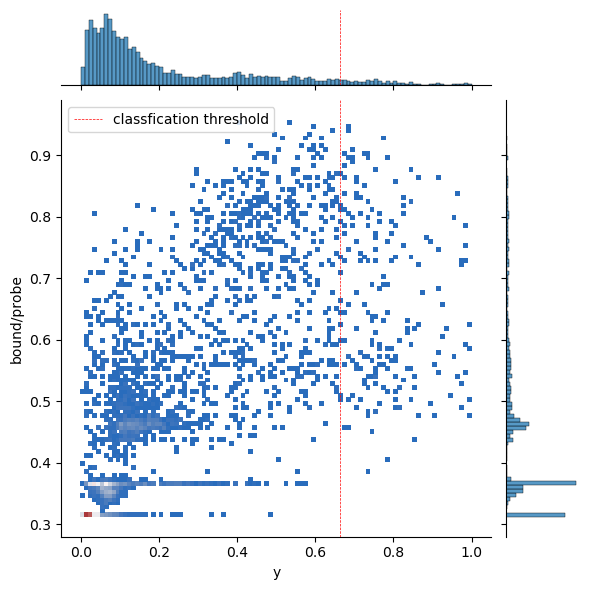

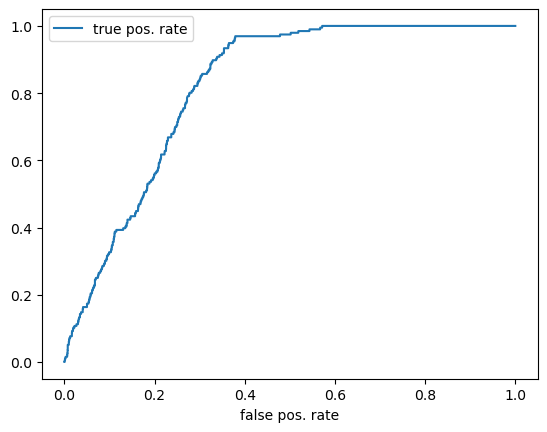

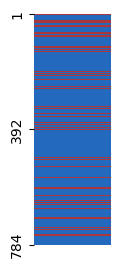

I: Classification performance AUROC: 0.8205


,stage,protein,# probes,motif length,r,AUROC,G0,G0 fitted,ratio,max binding,min binding,energies,model,logo
0,best repetition,T7 primase,3149,4,0.709102,0.829612,-8369.682846,True,3.143276,0.961111,0.305767,"-6305,..",suppressed,
1,mae optimzed,T7 primase,3149,4,0.695813,0.820490,-8369.682846,True,3.143276,0.957377,0.312217,"-5884,..",suppressed,

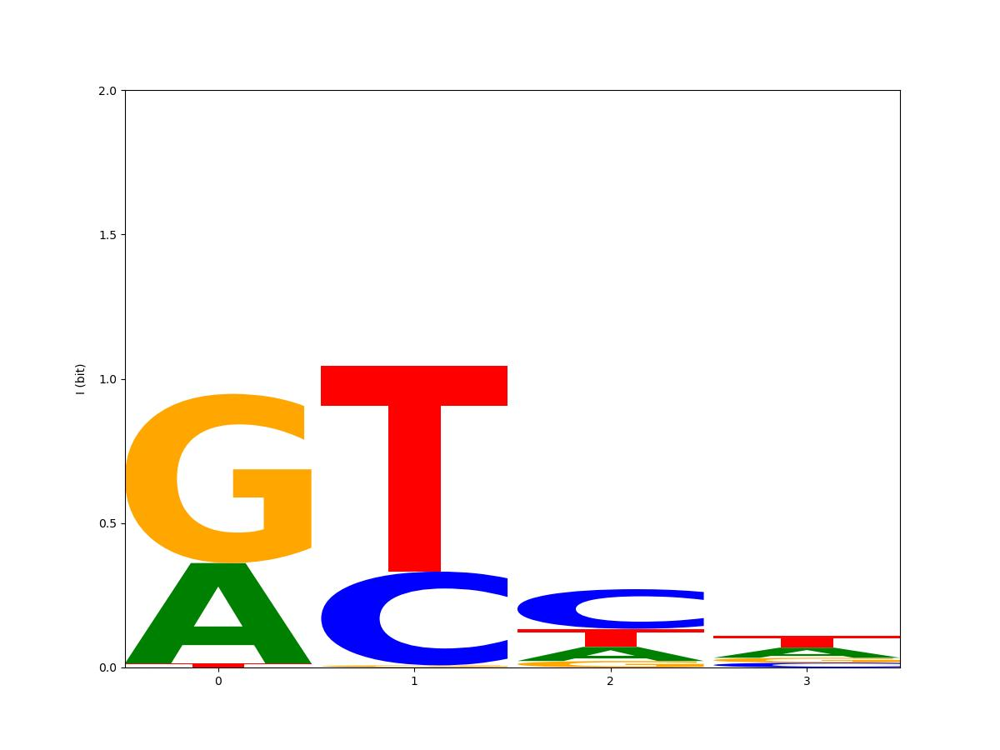
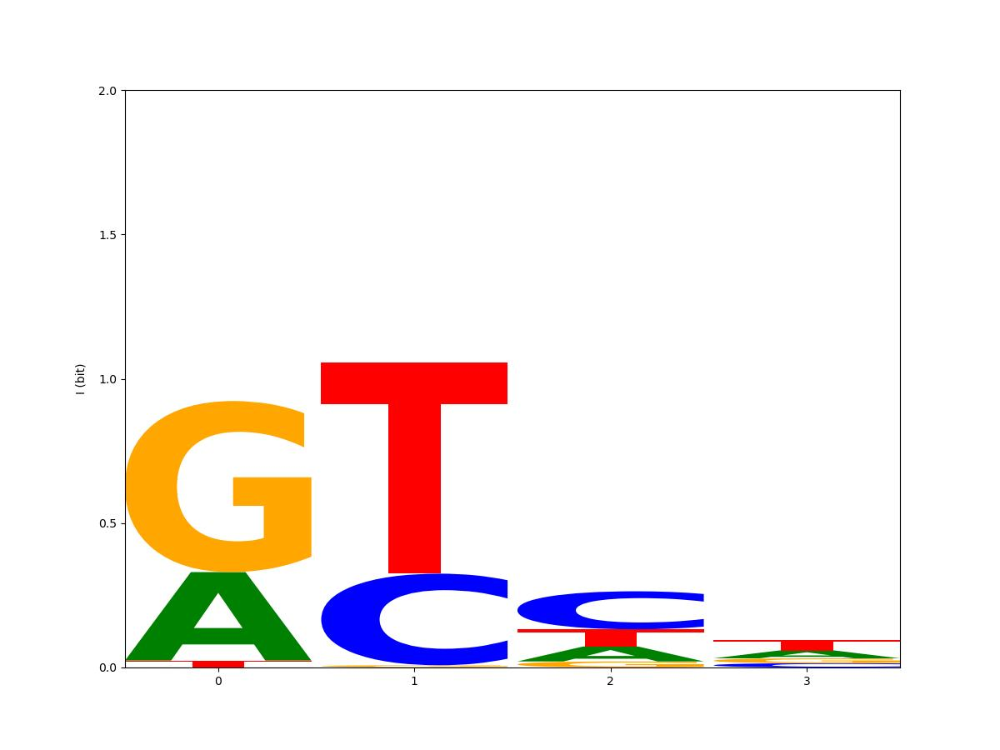

In [16]:
# refit model to minimize mae
last_model=STAGES.df.at[max(STAGES.df.index),'model']
refitted_model_best_repetition=model_best_repetition.refit_mae(X,y)

# print & display main results
refitted_model_best_repetition.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE)

# store results and display stages
STAGES.append('mae optimzed', refitted_model_best_repetition)
mf.display_df(STAGES.df, nuc_type=NUC_TYPE)

  0%|          | 0/6 [00:00<?, ?engine/s]

job5:   0%|          | 0/3 [00:00<?, ?tasks/s]

job3:   0%|          | 0/3 [00:00<?, ?tasks/s]

I: Optimization took 0.02 hours.


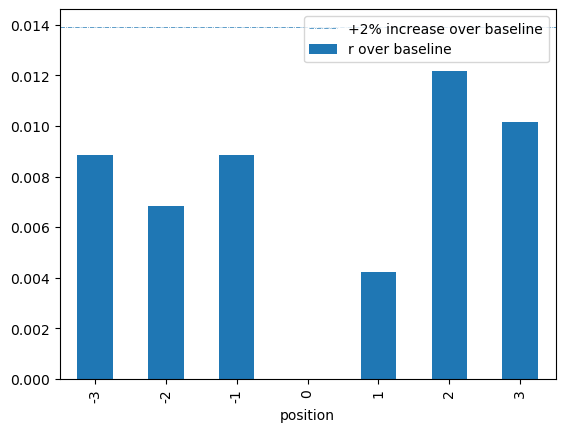

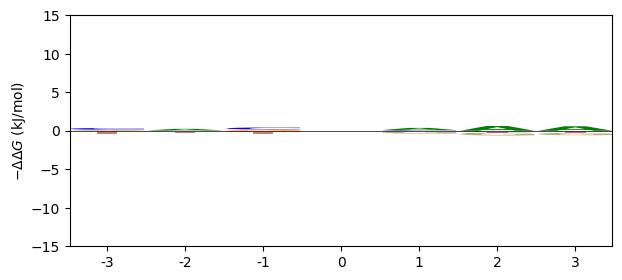

I: It is suggested to extend the core motif at the 5' end by 0 and at the 3' end by 0 positions.


In [17]:
### Based on the motif of CORE_MOTIF_LENGTH analyze the neigbouring positions 
### whether their inclusion can improve the quality of the motif
df_positions=model_best_repetition.investigate_extension_parallel(X, y, end5=3, end3=3, nuc_type=NUC_TYPE)

list_positions=df_positions.index[df_positions['+2%']].tolist()+[0] # list of positions with an increase of2% and default position 0
ext5=-min(list_positions)
ext3=max(list_positions)
print("I: It is suggested to extend the core motif at the 5' end by %i and at the 3' end by %i positions." %(ext5, ext3))

In [18]:
### fit & predict optimization starting with extended energy matrix if extension appears to improve prediction

if ext5+ext3!=0: #extension suggestion from previous analysis of the bordering positions
    expanded_energies=model_best_repetition.energies_
    # append energies of single-optimized bordering positions to energies of central part
    if ext5!=0:
        energies_5=np.concatenate(df_positions['energies'][(df_positions.index<0) & (df_positions.index>=-ext5)].to_numpy())
        expanded_energies=np.concatenate((energies_5, expanded_energies))
    if ext3!=0:
        energies_3=np.concatenate(df_positions['energies'][(df_positions.index<=ext3) & (df_positions.index>0)].to_numpy().flatten())
        expanded_energies=np.concatenate((expanded_energies,  energies_3))

    mf.energies2logo(expanded_energies, nuc_type=NUC_TYPE)
    print('I: Optimization started with following extended motif.')
    expanded_motif_length=len(expanded_energies)//4
    
    
    model_extended=mf.findmotif(motif_length=expanded_motif_length, protein_conc=PROT_CONC, both_strands=BOTH_STRANDS,
                   start=expanded_energies, fit_G0=True)

    start = time()
    model_extended.fit(X,y)
    print("Optimization took %.2f hours." % ((time() - start)/3600))

    # print & display main results
    model_extended.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE)

    # store results and display stages
    STAGES.append('extended', model_extended)
    mf.display_df(STAGES.df, nuc_type=NUC_TYPE)
else:
    print('I: Motif is not extended based on previous analysis.')

I: Motif is not extended based on previous analysis.


I: At least one of the bordering positions of the current motif has an information content of at least 0.25. Extending.


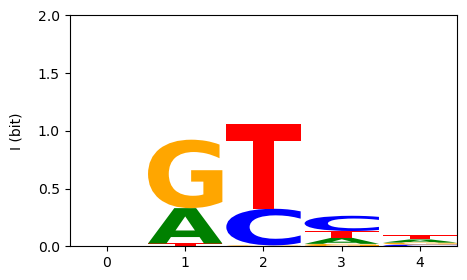

Optimization took 0.25 hours.
I: energy matrix and logos:



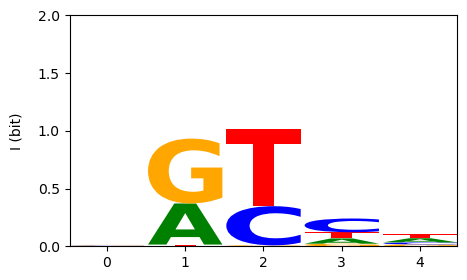

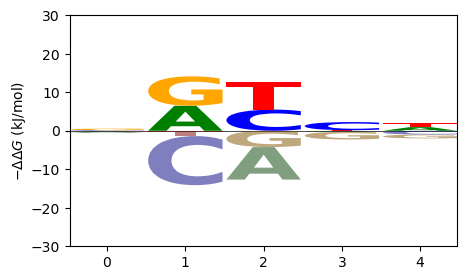


       A      C     G     T
0   467   -139  -407    79
1 -6500  12755 -7629  1374
2  8439  -5499  4236 -7176
3   261  -2117  2001  -145
4  -940    976  1008 -1044

I: summed absolute energies of each position:
0     1094
1    28260
2    25351
3     4526
4     3970
dtype: int64

I: averaged summed energy over all positions: 12640
I: Mean and Standard Deviation for the Free Energy G to all subsequences of all probes: -8898 +/- 9231
I: Plot of the Occupancy of a subsite as the function of the Free Energy G 
   overlaid with the distribution of the Free Energy of all subsites.
I: There shall be only a small overlap of both curves. i.e. only the most negative Free Energies
    lead to a measurable occupancy.


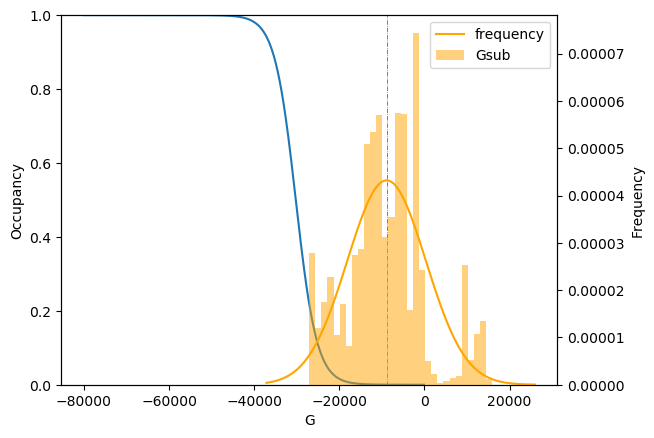

I: Calculated occupancy over all subsite of a single probe:
   binding:  0.25453 .. 0.98793 (ratio: 3.9)
I: number of probes: 3149
I: Pearson Correlation  r: 0.7171
I: mean absolute error: 0.1013


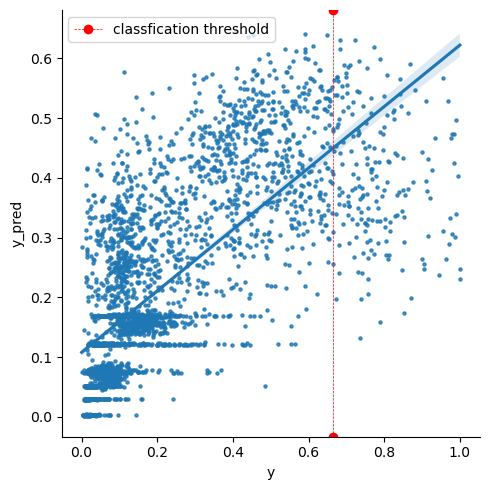

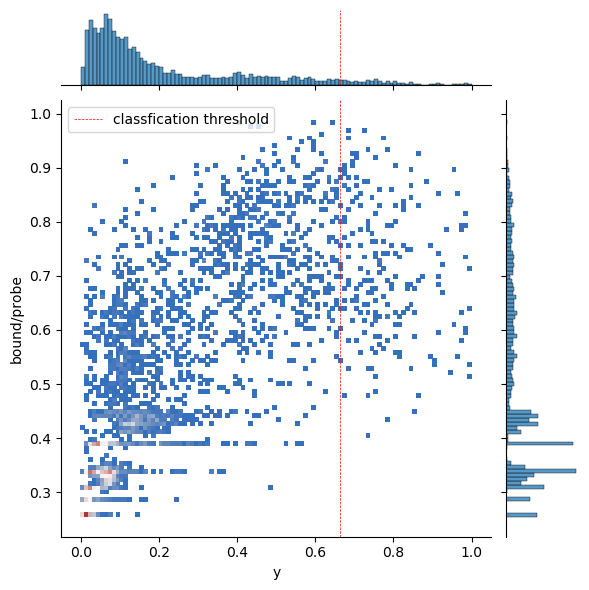

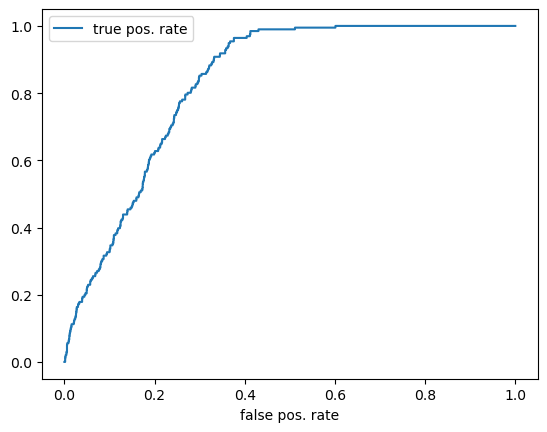

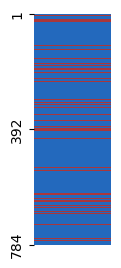

I: Classification performance AUROC: 0.8313


,stage,protein,# probes,motif length,r,AUROC,G0,G0 fitted,ratio,max binding,min binding,energies,model,logo
0,best repetition,T7 primase,3149,4,0.709102,0.829612,-8369.682846,True,3.143276,0.961111,0.305767,"-6305,..",suppressed,
1,mae optimzed,T7 primase,3149,4,0.695813,0.820490,-8369.682846,True,3.143276,0.957377,0.312217,"-5884,..",suppressed,
2,"expanded, border",T7 primase,3149,5,0.717139,0.831264,-8730.333206,True,3.881376,0.987928,0.254530,"467,..",suppressed,

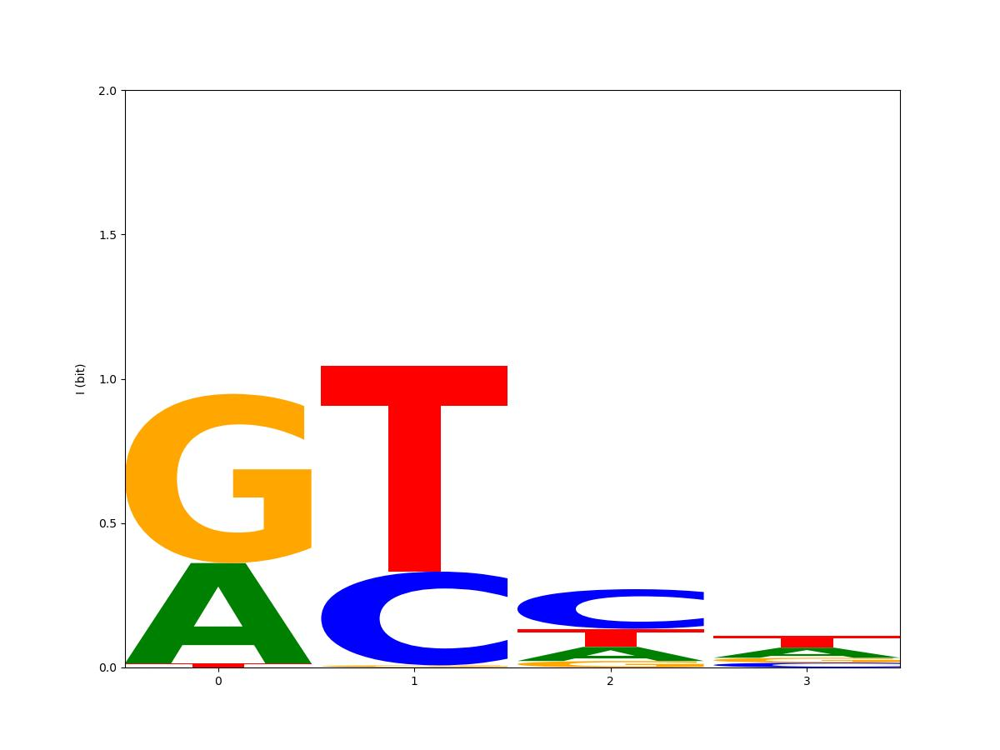
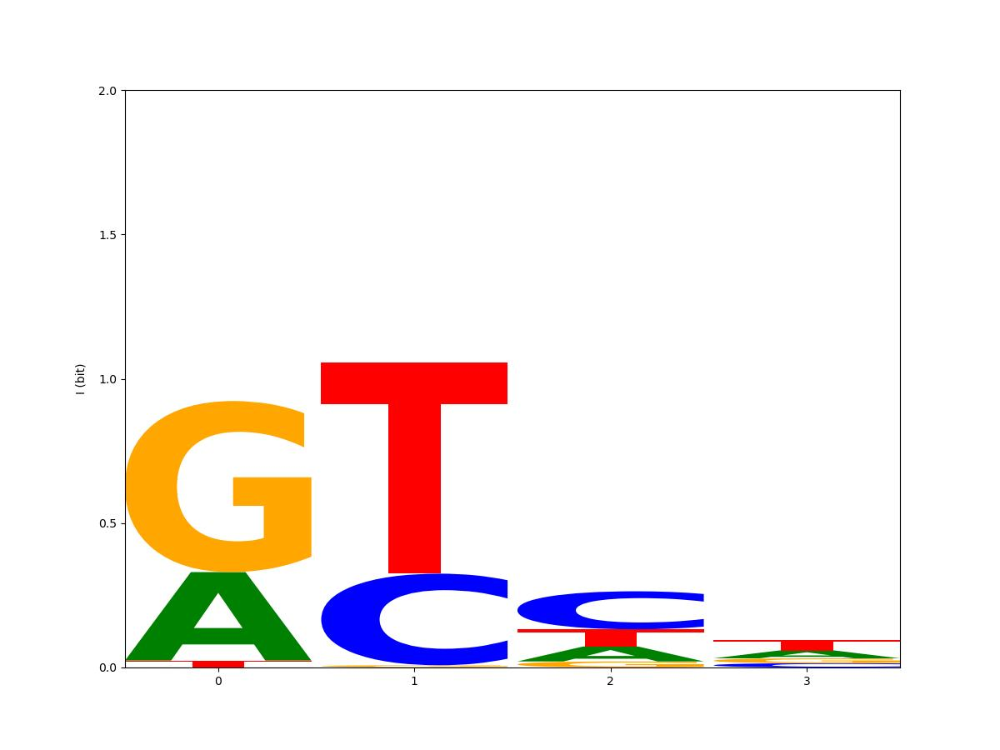
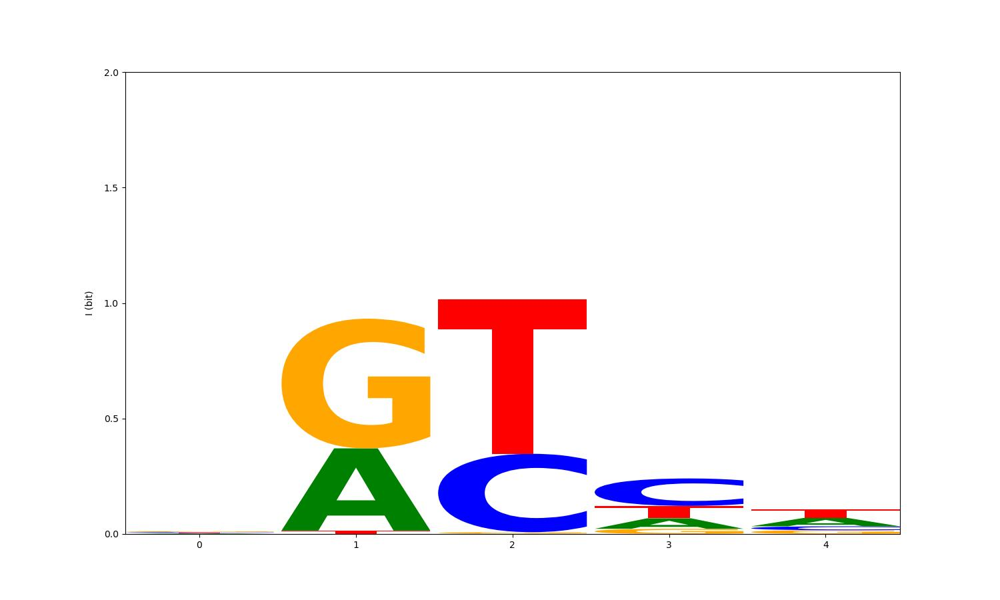

In [19]:
### fit & predict optimization starting with extended energy matrix plus one bordering position on each side if current bordering position exceed the information of 0.25

last_model=STAGES.df.at[max(STAGES.df.index),'model']
I_5=mf.energies2information(last_model.energies_[0:4])>=0.25 #sufficient information content of 5' end position
I_3=mf.energies2information(last_model.energies_[-4:])>=0.25 #sufficient information content of 3' end position

if I_5 or I_3:
    print('I: At least one of the bordering positions of the current motif has an information content of at least 0.25. Extending.')
    expanded_energies_with_border=mf.modify_energies(last_model.energies_, end5=I_5, end3=I_3)  
    mf.energies2logo(expanded_energies_with_border, nuc_type=NUC_TYPE)
    motif_length_with_border=len(expanded_energies_with_border)//4

    model_with_border=mf.findmotif(motif_length=motif_length_with_border, protein_conc=PROT_CONC, both_strands=BOTH_STRANDS,
                   start=expanded_energies_with_border, fit_G0=True)


    start = time()
    model_with_border.fit(X,y)
    print("Optimization took %.2f hours." % ((time() - start)/3600))

    # print & display main results
    model_with_border.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE)

    # store results and display stages
    STAGES.append('expanded, border', model_with_border)
    mf.display_df(STAGES.df, nuc_type=NUC_TYPE)
else:
    print('I: Both bordering positions of the found motif have an information content below 0.25. No futher optimization required.')

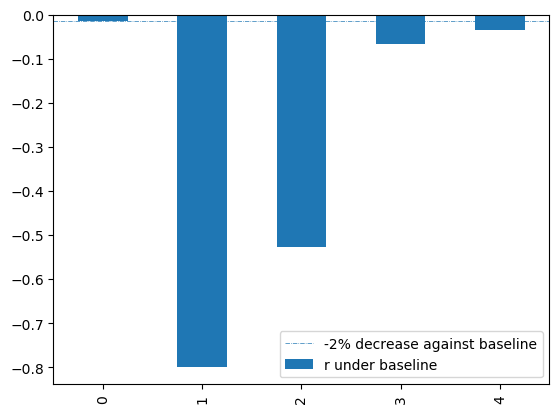

I: The analysis suggests, that positions between 1 to 4 contribute significantly to the motif
I: No need for a further optimization. An optimization with motif length of 4 has already been done.
I: Checking whether G0 has been chosen correctly.
I: Current G0 = -8730 J/mol (see red broken line in figure below) with r = 0.717.
I: Maximal r is 0.718 at G0=-5730 J/mol (see green broken line below).
I: Maximal occupancy of 2 is reached at G0=-10730 J/mol (see blue broken line below).
I: Maximal occupancy of 0.2 is reached at G0=-4730 J/mol (see blue broken line below).


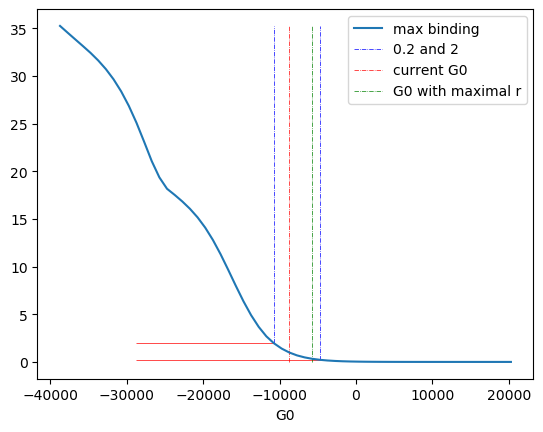

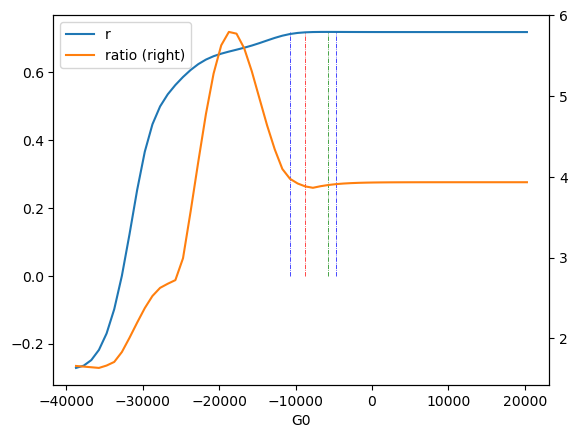

I: G0 is in a range leading to maximal probe occupancy between 0.2 and 2. Good.
I: Maximal r is close to r achieved with current G0. Good.


In [20]:
last_model=STAGES.df.at[max(STAGES.df.index),'model']
df_relevant_positions=last_model.explore_positions(X, y)
list_positions=df_relevant_positions.index[df_relevant_positions['-2%']].tolist() # list of positions with an increase of2% and default position 0
start_relevant=min(list_positions)
end_relevant=max(list_positions)
red5=-start_relevant
red3=end_relevant-len(df_relevant_positions)+1
print('I: The analysis suggests, that positions between %i to %i contribute significantly to the motif' %(start_relevant, end_relevant))
last_model=STAGES.df.at[max(STAGES.df.index),'model']

if (end_relevant-start_relevant+1)in STAGES.df['motif length'].to_list():
    print('I: No need for a further optimization. An optimization with motif length of %i has already been done.' %(end_relevant-start_relevant+1))
    print('I: Checking whether G0 has been chosen correctly.')
    last_model.investigate_G0(X, y)
else:
    print('I: Bordering positions only marginally contributing towards regression quality are dropped.')
    print('I: New start energy for motif optimization:')
    start_final_model=mf.modify_energies(last_model.energies_, end5=red5, end3=red3)
    mf.energies2logo(start_final_model, nuc_type=NUC_TYPE)
    final_model=mf.findmotif(motif_length=len(start_final_model)//4, protein_conc=PROT_CONC, 
                             both_strands=BOTH_STRANDS, start=start_final_model)

    start = time()
    final_model.fit(X,y)
    print("Optimization took %.2f hours." % ((time() - start)/3600))

    # print & display main results
    final_model.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE)
    
    print('I: Checking whether G0 has been chosen correctly.')
    final_model.investigate_G0(X, y)

    # store results and display stages
    STAGES.append('shrinked', final_model)
    mf.display_df(STAGES.df, nuc_type=NUC_TYPE)  

Optimization terminated successfully.
         Current function value: 0.096996
         Iterations: 14
         Function evaluations: 3483
I: energy matrix and logos:



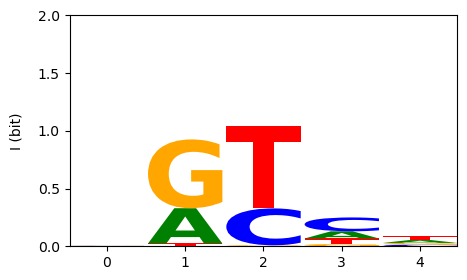

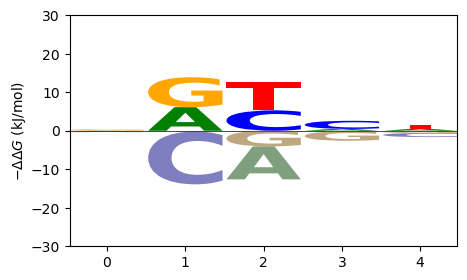


       A      C     G     T
0   354    -41  -284   -28
1 -6129  13736 -7781   175
2  8557  -5309  4058 -7305
3  -484  -2105  2435   154
4  -479   1055   573 -1149

I: summed absolute energies of each position:
0      709
1    27823
2    25231
3     5178
4     3258
dtype: int64

I: averaged summed energy over all positions: 12440
I: Mean and Standard Deviation for the Free Energy G to all subsequences of all probes: -8888 +/- 9642
I: Plot of the Occupancy of a subsite as the function of the Free Energy G 
   overlaid with the distribution of the Free Energy of all subsites.
I: There shall be only a small overlap of both curves. i.e. only the most negative Free Energies
    lead to a measurable occupancy.


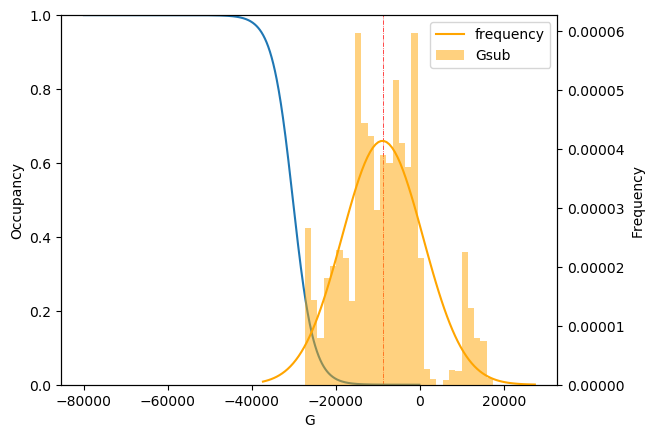

I: Calculated occupancy over all subsite of a single probe:
   binding:  0.31321 .. 1.06356 (ratio: 3.9)
I: number of probes: 3149
I: Pearson Correlation  r: 0.6981
I: mean absolute error: 0.0970


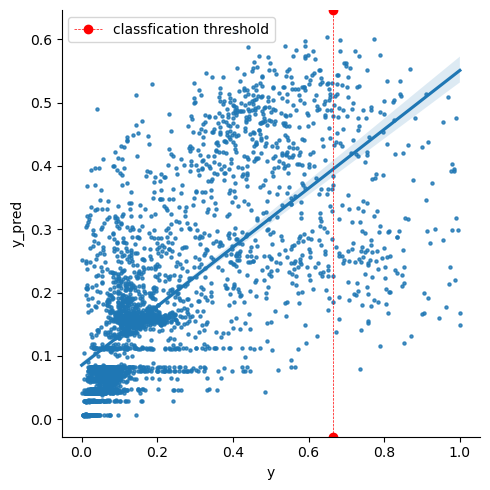

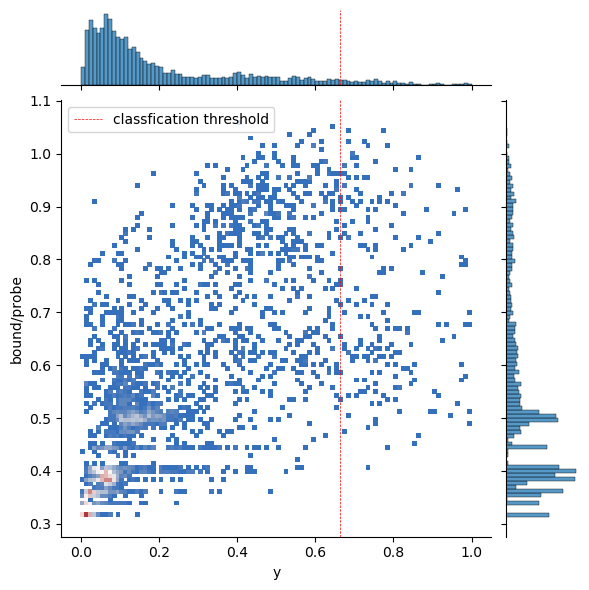

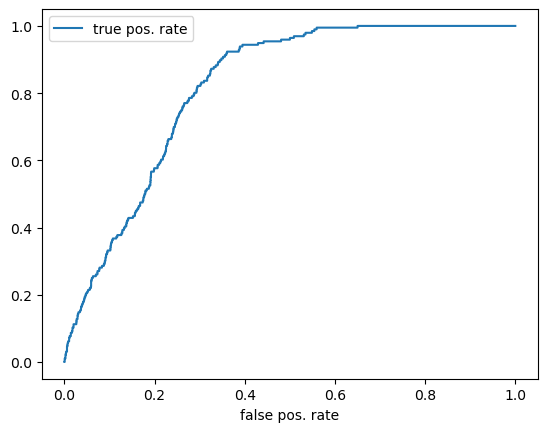

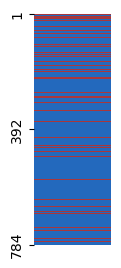

I: Classification performance AUROC: 0.8165


,stage,protein,# probes,motif length,r,AUROC,G0,G0 fitted,ratio,max binding,min binding,energies,model,logo
0,best repetition,T7 primase,3149,4,0.709102,0.829612,-8369.682846,True,3.143276,0.961111,0.305767,"-6305,..",suppressed,
1,mae optimzed,T7 primase,3149,4,0.695813,0.820490,-8369.682846,True,3.143276,0.957377,0.312217,"-5884,..",suppressed,
2,"expanded, border",T7 primase,3149,5,0.717139,0.831264,-8730.333206,True,3.881376,0.987928,0.254530,"467,..",suppressed,
3,final mae optimzed,T7 primase,3149,5,0.698074,0.816455,-8730.333206,True,3.881376,1.063557,0.313207,"354,..",suppressed,

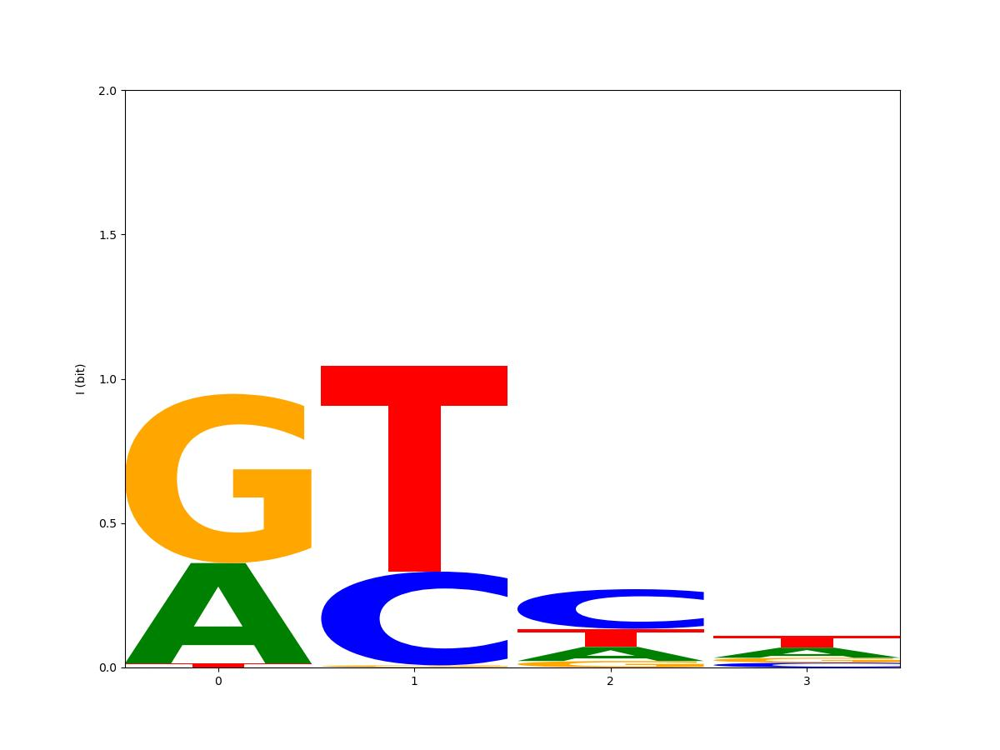
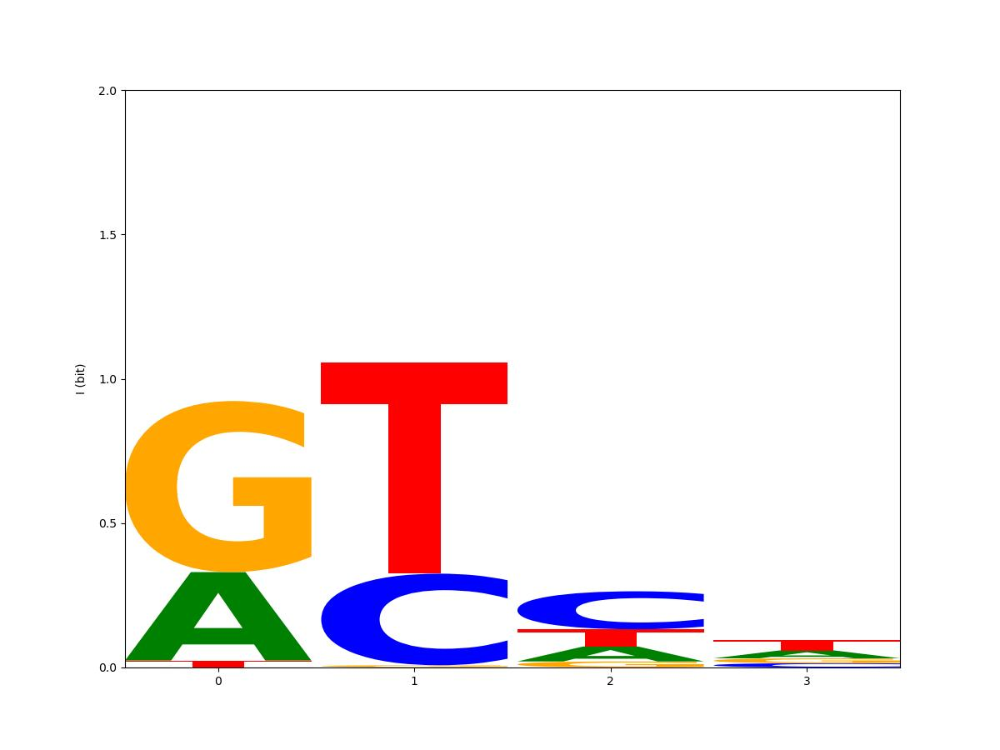
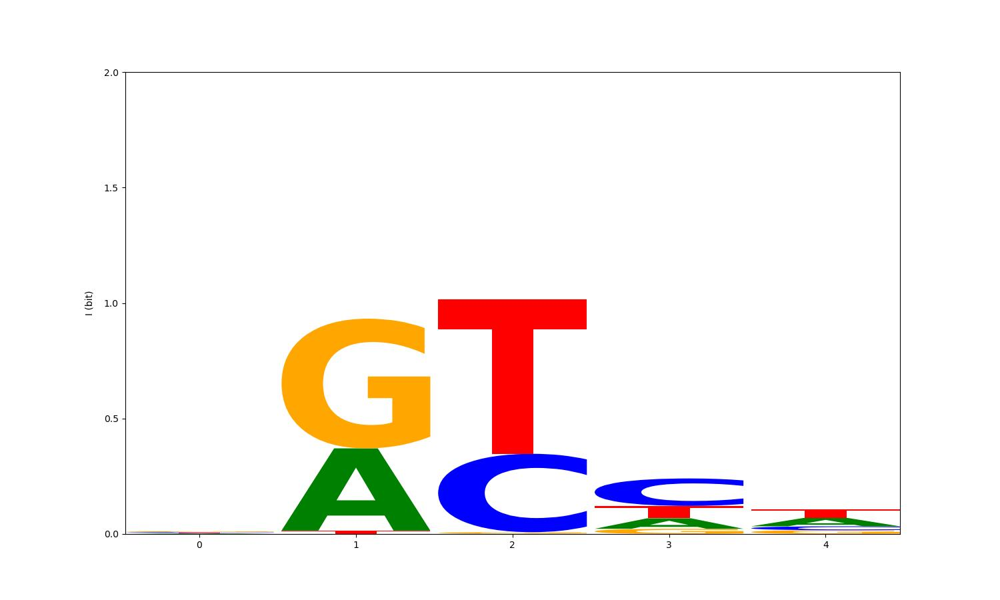
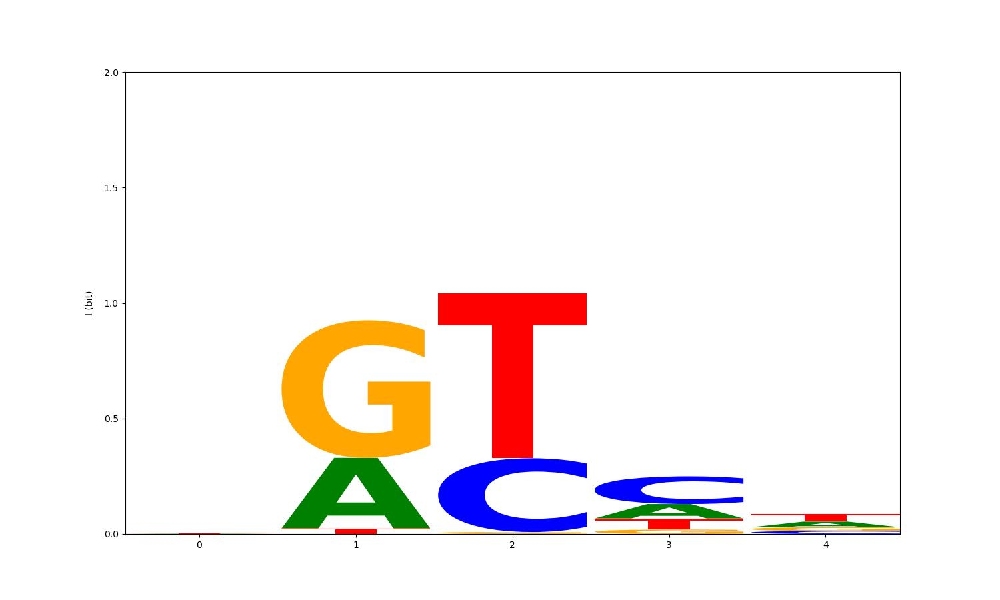

In [21]:
# refit model to minimize mae
last_model=STAGES.df.at[max(STAGES.df.index),'model']
refitted_model=last_model.refit_mae(X,y)

# print & display main results
refitted_model.analyse_motif(X,y, THRESHOLD, nuc_type=NUC_TYPE)

# store results and display stages
STAGES.append('final mae optimzed', refitted_model)
mf.display_df(STAGES.df, nuc_type=NUC_TYPE)

In [22]:
STAGES.df['energies'].apply(mf.energies2information)

0    2.372494
1    2.338378
2    2.306898
3    2.309537
Name: energies, dtype: float64

In [24]:
STAGES.df.to_json('%s_%s-%s-%s_%s-%s.json' %(PROTEIN_NAME, datetime.now().year, datetime.now().month,datetime.now().day , datetime.now().hour, datetime.now().minute))